<a href="https://www.kaggle.com/code/romikgosai/imgcolorizefeb-4-batch16?scriptVersionId=161666340" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

In [1]:
import tensorflow as tf
import os
import numpy as np
import matplotlib.pyplot as plt
import time
import cv2
from tensorflow.keras import layers
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import Dense, Conv2D, Flatten, BatchNormalization, LeakyReLU
from tensorflow.keras.layers import Conv2DTranspose, Dropout, ReLU, Input, Concatenate, ZeroPadding2D
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import plot_model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow_addons as tfa
import tensorflow_hub as hub

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"
/opt/conda/lib/python3.10/site-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


In [2]:
import tensorflow as tf

physical_devices = tf.config.list_physical_devices('GPU')
if len(physical_devices) == 0:
    print("No GPU devices found. Make sure your GPU is properly installed and configured.")
else:
    tf.config.experimental.set_memory_growth(physical_devices[0], True)
    print("GPU configured successfully.")

GPU configured successfully.


In [3]:
import tensorflow as tf

# Check available GPUs
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    # Restrict TensorFlow to only allocate GPU memory growth
    try:
        tf.config.experimental.set_memory_growth(gpus[0], True)
        print("GPU memory growth set to True")
    except RuntimeError as e:
        print(e)

GPU memory growth set to True


In [4]:
import tensorflow as tf

# Check if TensorFlow can access GPU
num_gpus = len(tf.config.experimental.list_physical_devices('GPU'))

if num_gpus > 0:
    print("Num GPUs Available: ", num_gpus)
    print("TensorFlow is using GPU.")
else:
    print("No GPU available. TensorFlow is using CPU.")


Num GPUs Available:  1
TensorFlow is using GPU.


In [5]:
def load(image_file):
    image = tf.io.read_file(image_file)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.cast(image,tf.float32)
    return image

In [6]:
path = "/kaggle/input/monumentimagenotaugmented/"
x = load(os.path.join(path, 'train/Train_3221.jpg'))
print(x.shape)

(300, 300, 3)


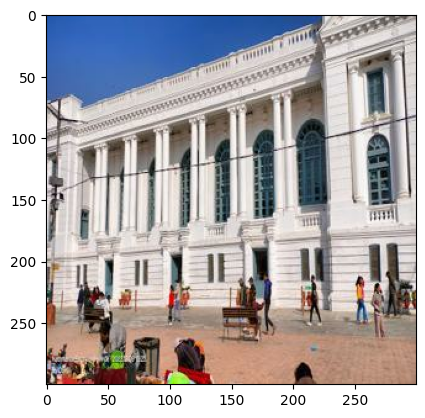

In [7]:
plt.imshow(x/255.0)

In [8]:
def normalize(real_image):
    real_image = (real_image / 255)
    return real_image

In [9]:
def random_crop(real_image):
    cropped_image = tf.image.random_crop(real_image, size = [256, 256, 3])
    return cropped_image

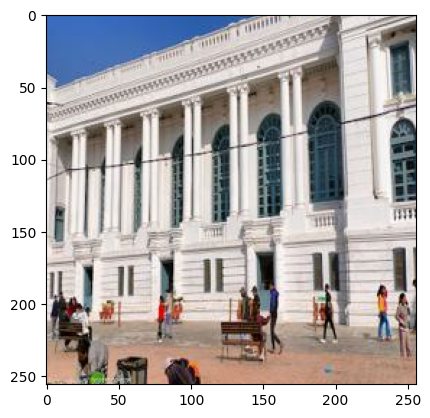

In [10]:
x_aug = random_crop(x)
plt.imshow(x_aug/255.0)

In [11]:
def resize(real_image):
    real_image = tf.image.resize(real_image, [256, 256], method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
    return real_image

In [12]:
def rotate_image(image, angles, interpolation='BILINEAR'):
    """
    Rotate an image tensor by specified angles.

    Args:
    - image: Input image tensor with shape (batch_size, height, width, channels).
    - angles: Tensor of rotation angles in radians for each image in the batch.
    - interpolation: Interpolation method ('BILINEAR' or 'NEAREST').

    Returns:
    - Rotated image tensor.
    """
    batch_size, height, width, channels = tf.unstack(tf.shape(image))

    # Coordinates of the center of the image
    center_x = tf.cast(width, tf.float32) / 2.0
    center_y = tf.cast(height, tf.float32) / 2.0

    # Define transformation matrix
    rotation_matrix = tf.reshape(tf.stack([tf.cos(angles), -tf.sin(angles), center_x * (1 - tf.cos(angles)) + center_y * tf.sin(angles),
                                           tf.sin(angles), tf.cos(angles), -center_x * tf.sin(angles) + center_y * (1 - tf.cos(angles)),
                                           0.0, 0.0, 1.0], axis=1), shape=(-1, 3, 3))

    # Apply rotation to each pixel
    rotated_image = tfa.image.transform(image, rotation_matrix, interpolation)

    return rotated_image


In [13]:
def random_jitter(real_image):
    if tf.random.uniform(()) > 0.5:
        real_image = tf.image.flip_left_right(real_image)
    return real_image

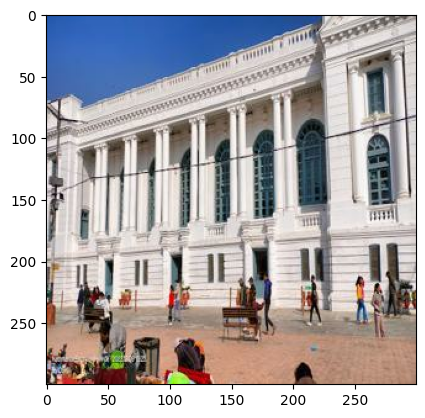

In [14]:
x_jitter = random_jitter(x)
plt.imshow(x_jitter/255.0)

In [15]:
def load_train_images(image_path):
    real_image = load(image_path)
    real_image = tf.image.random_brightness(real_image, 0.2)
    real_image = random_crop(real_image)
    # Define the rotation angle in radians
    rotation_angle = tf.constant(20.0 * (3.141592653589793 / 180.0), dtype=tf.float32)

    # Apply the rotation using tfa.image.rotate
    real_image = tfa.image.rotate(real_image, angles=rotation_angle)

#     # Example usage
#     angles = tf.placeholder(dtype=tf.float32, shape=(None,))
#     # Specify the rotation range in degrees
#     rotation_range = 15  # Adjust this value as needed
#     # Convert the rotation range to radians
#     rotation_range_rad = rotation_range * (np.pi / 180.0)
#     # Generate random rotation angles for each image in the batch
#     random_angles = tf.random.uniform(shape=(tf.shape(image)[0],), minval=-rotation_range_rad, maxval=rotation_range_rad)
#     # Apply custom rotation to the image with bilinear interpolation
#     real_image = rotate_image(real_image, random_angles, interpolation='BILINEAR')
    #     real_image = rotate(real_image)
    real_image = random_jitter(real_image)
    real_image = normalize(real_image)
    yuv_image = tf.image.rgb_to_yuv(real_image)
    # Separate LAB into L and AB components
    Y_channel = tf.expand_dims(yuv_image[:, :, 0], axis=-1)  # L channel
    UV_channels = yuv_image[:, :, 1:]  # AB channels
    #here L_channel becomes input i.e light/luminance of pixel and AB_channels become target
    return Y_channel, UV_channels

In [16]:
def load_test_image(image_path):
    real_image = load(image_path)
    real_image = resize(real_image)
    real_image = normalize(real_image)
    yuv_image = tf.image.rgb_to_yuv(real_image)
    # Separate LAB into L and AB components
    Y_channel = tf.expand_dims(yuv_image[:, :, 0], axis=-1)  # L channel
    UV_channels = yuv_image[:, :, 1:]  # AB channels
    #here L_channel becomes input i.e light/luminance of pixel and AB_channels become target
    return Y_channel, UV_channels

In [17]:
IMAGE_SIZE = 256
BATCH_SIZE = 16

In [18]:
# create input pipeline
train_dataset = tf.data.Dataset.list_files(path + "train/*.jpg")
train_dataset = train_dataset.map(load_train_images)
train_dataset = train_dataset.shuffle(10).batch(BATCH_SIZE)
train_dataset

<_BatchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 1), dtype=tf.float32, name=None), TensorSpec(shape=(None, 256, 256, 2), dtype=tf.float32, name=None))>

In [19]:
test_dataset = tf.data.Dataset.list_files(path + 'val/*.jpg')
test_dataset = test_dataset.map(load_test_image)
test_dataset = test_dataset.batch(BATCH_SIZE)
test_dataset

<_BatchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 1), dtype=tf.float32, name=None), TensorSpec(shape=(None, 256, 256, 2), dtype=tf.float32, name=None))>

In [20]:
# # Load pre-trained VGG model
# vgg_model = tf.keras.applications.VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# # Freeze the VGG model layers
# vgg_model.trainable = False

# # Define function to preprocess images
# def preprocess_image(image):
#     image = tf.image.resize(image, (224, 224))
#     image = tf.keras.applications.vgg16.preprocess_input(image)
#     return image

# # Define function to compute LPIPS score
# def compute_lpips_score(image1, image2):
#     image1_features = vgg_model(preprocess_image(image1))
#     image2_features = vgg_model(preprocess_image(image2))
#     lpips_distance = tf.norm(image1_features - image2_features, ord='euclidean', axis=1)
#     return lpips_distance.numpy()

In [21]:
# downsample block
def downsample(filters, size,dropout=False, batchnorm = True):
    init = tf.random_normal_initializer(0.,0.02)
    result = Sequential()
    result.add(Conv2D(filters, size, strides = 2, padding = "same", kernel_initializer = init, use_bias = False))
    if batchnorm == True:
        result.add(BatchNormalization())
    if dropout == True :
        result.add(Dropout(0.3))
    result.add(LeakyReLU())
    return result
down_model = downsample(3,4)
down_result = down_model(tf.expand_dims(x, axis = 0))
print(down_result.shape)

(1, 150, 150, 3)


In [22]:
# upsample block
def upsample(filters, size, dropout = False):
    init = tf.random_normal_initializer(0, 0.02)
    result = Sequential()
    result.add(Conv2DTranspose(filters, size, strides = 2, padding = "same", kernel_initializer = init, use_bias = False))
    result.add(BatchNormalization())
    if dropout == True:
        result.add(Dropout(0.3))
    result.add(ReLU())
    return result
up_model = upsample(3,4)
up_result = up_model(down_result)
print(up_result.shape)

(1, 300, 300, 3)


In [23]:
def generator(input_shape = (256,256,1), output_channels = 2):
    inputs = Input(shape = input_shape)
    down_stack = [
        downsample(8, 4, batchnorm=False),
        downsample(16, 4),
        downsample(32, 4),
        downsample(64, 4, dropout = True),
        downsample(128, 4, dropout = True),
        downsample(256, 4, dropout = True),
        downsample(256, 4, dropout = True)
    ]

    up_stack = [
        upsample(256, 4, dropout = True),
        upsample(128, 4, dropout=True),
        upsample(64, 4, dropout=True),
        upsample(32, 4, dropout=True),
        upsample(16, 4),
        upsample(8, 4),
    ]
    init = tf.random_normal_initializer(0., 0.02)
    last = Conv2DTranspose(2, 4, strides = 2, padding = "same", kernel_initializer = init, activation ="tanh")
    x = inputs
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
    skips = reversed(skips[:-1])

    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = Concatenate()([x, skip])

    x = last(x)
    return Model(inputs = inputs, outputs = x)

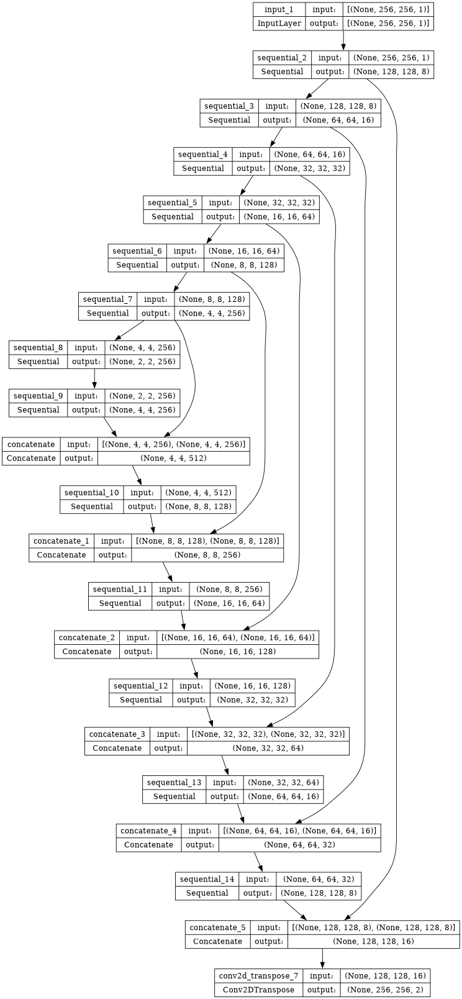

In [24]:
gen = generator()
plot_model(gen, show_shapes=True, dpi = 64)

In [25]:
def discriminator():
    init = tf.random_normal_initializer(0., 0.02)
    tar = Input(shape = [IMAGE_SIZE, IMAGE_SIZE, 2], name = "target_image")
    down1 = downsample(64,4,False)(tar)
    down2 = downsample(128, 4)(down1)
    down3 = downsample(256, 4)(down2)

    zero_pad1 = ZeroPadding2D()(down3)
    conv = Conv2D(256, 4, strides = 1, kernel_initializer = init, use_bias = False)(zero_pad1)
    leaky_relu = LeakyReLU()(conv)
    zero_pad2 = ZeroPadding2D()(leaky_relu)
    last = Conv2D(1, 4, strides = 1, kernel_initializer=init)(zero_pad2)
    return Model(inputs = tar, outputs = last)

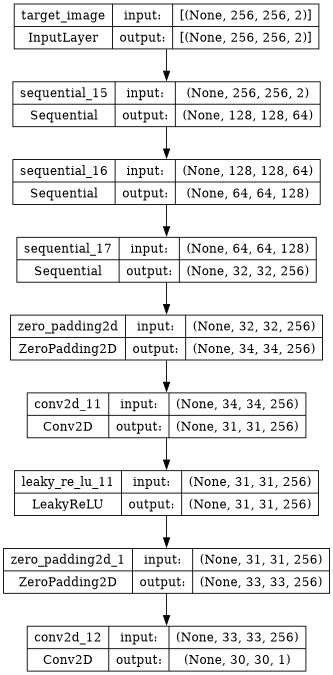

In [26]:
disc = discriminator()
plot_model(disc, show_shapes=True, dpi = 64)

In [27]:
# Function to create YUV image from Y, U, and V channels and then convert to rgb
def create_rgb_image(y_channel, uv_channel):
    # Assuming YUV format where Y, U, and V channels are separate
    # y_channel = np.array(y_channel)
    # uv_channel = np.array(uv_channel)
    u_channel, v_channel = tf.split(uv_channel, num_or_size_splits=2, axis=-1)

    # Combine Y, U, and V channels into a YUV image
    rgb_image = tf.image.yuv_to_rgb(tf.concat([y_channel, u_channel, v_channel], axis=-1))
    return rgb_image


In [28]:
from tensorflow.keras.applications import VGG19
from tensorflow.keras.losses import BinaryCrossentropy, MeanAbsoluteError, MeanSquaredError

# Define generator and discriminator architectures
# Define generator and discriminator models

# Load pre-trained VGG19 model for perceptual loss
# vgg_model = VGG19(weights='imagenet', include_top=False)

# Define loss functions
bce_loss = BinaryCrossentropy(from_logits=True)
mae_loss = MeanAbsoluteError()
mse_loss = MeanSquaredError()

In [29]:
lambda_adv = 1
lambda_l1 = 80
lambda_l2 = 15
lambda_perceptual = 0.2

In [30]:
# def perceptual_loss(y_true, y_pred):
#     y_true = tf.keras.applications.vgg19.preprocess_input(y_true)
#     y_pred = tf.keras.applications.vgg19.preprocess_input(y_pred)
#     features_true = vgg_model(y_true)
#     features_pred = vgg_model(y_pred)
#     return mae_loss(features_true, features_pred)


In [31]:
def generator_loss(disc_generated_output, input_image, generated_images, real_images):
    adv_loss = bce_loss(tf.ones_like(disc_generated_output), disc_generated_output)

    # Compute L1 loss
    l1_loss = mae_loss(real_images, generated_images)

    # Compute L2 loss
#     l2_loss = mse_loss(real_images, generated_images)

    # Compute perceptual loss
#     perceptual_loss_val = perceptual_loss(create_rgb_image(input_image, real_images), create_rgb_image(input_image,generated_images))

    # Total generator loss
    gen_loss =  lambda_adv * adv_loss + lambda_l1 * l1_loss 
    return gen_loss, adv_loss, l1_loss, 0,0 

In [32]:
from keras.losses import BinaryCrossentropy
loss_function = BinaryCrossentropy(from_logits=True)

In [33]:
def discriminator_loss(disc_real_output, disc_generated_output):
    real_loss = loss_function(tf.ones_like(disc_real_output), disc_real_output)
    generated_loss = loss_function(tf.zeros_like(disc_generated_output), disc_generated_output)
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss, real_loss, generated_loss

In [34]:
generator_optimizer = Adam(lr= 2e-5, beta_1=0.5)
discriminator_optimizer = Adam(lr = 2e-5, beta_1=0.5)

In [35]:
epochs = 150

In [36]:
import tensorflow as tf
from tensorflow.keras.applications import VGG19
from tensorflow.keras.models import Model

# Load the VGG19 model
vgg = VGG19(weights='imagenet', include_top=False)

# Select the layers you want to use for the LPIPS score
selected_layers = ['block1_conv1', 'block2_conv1', 'block3_conv1']

# Create a model that outputs the selected layers
outputs = [vgg.get_layer(name).output for name in selected_layers]
model = Model(inputs=vgg.input, outputs=outputs)

# Make sure the VGG model is not trainable
model.trainable = False

def lpips_score(image1, image2):
    # Get the features for both images
    image1_features = model(image1)
    image2_features = model(image2)

    # Initialize the score
    score = 0

    # For each feature layer...
    for f1, f2 in zip(image1_features, image2_features):
        # ... compute the mean squared error between the features
        mse = tf.reduce_mean((f1 - f2)**2)
        # ... and add it to the score
        score += mse

    return score

80134624/80134624 [==============================] - 0s 0us/step


In [37]:
@tf.function
def train_step(input_image, target, epoch, training_discriminator):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        gen_output = gen(input_image, training=True)
        disc_real_output = disc( target, training=True)
        disc_generated_output = disc(gen_output, training=True)
        gen_total_loss, gen_adv_loss, gen_l1_loss, gen_l2_loss, gen_perceptual_loss = generator_loss(disc_generated_output,input_image, gen_output, target)
        disc_loss, disc_real_loss, disc_generated_loss = discriminator_loss(disc_real_output, disc_generated_output)

        ssim_values = tf.image.ssim(create_rgb_image(input_image, target), create_rgb_image(input_image,gen_output), max_val=1.0)
        psnr_values = tf.image.psnr(create_rgb_image(input_image, target), create_rgb_image(input_image,gen_output), max_val=1.0)
        lpips_values = lpips_score(create_rgb_image(input_image, target), create_rgb_image(input_image,gen_output))
#         if epoch > 10:
        if training_discriminator:
            discriminator_gradients = disc_tape.gradient(disc_loss, disc.trainable_variables)
            discriminator_optimizer.apply_gradients(zip(discriminator_gradients, disc.trainable_variables))
        else:
            generator_gradients = gen_tape.gradient(gen_total_loss, gen.trainable_variables)
            generator_optimizer.apply_gradients(zip(generator_gradients, gen.trainable_variables))
#         else:
#             generator_gradients = gen_tape.gradient(gen_total_loss, gen.trainable_variables)
#             discriminator_gradients = disc_tape.gradient(disc_loss, disc.trainable_variables)
#             generator_optimizer.apply_gradients(zip(generator_gradients, gen.trainable_variables))
#             discriminator_optimizer.apply_gradients(zip(discriminator_gradients, disc.trainable_variables))

        return gen_total_loss, gen_adv_loss, gen_l1_loss, gen_l2_loss, gen_perceptual_loss, disc_loss,disc_real_loss, disc_generated_loss, ssim_values, psnr_values, lpips_values

In [38]:
@tf.function
def test_step(input_image, target):
    # Generate output using the generator
    gen_output = gen(input_image)

    # Calculate losses without updating gradients
    disc_real_output = disc( target)
    disc_generated_output = disc(gen_output)

    gen_total_loss, gen_adv_loss, gen_l1_loss, gen_l2_loss, gen_perceptual_loss = generator_loss(disc_generated_output,input_image, gen_output, target)
    disc_loss,disc_real_loss, disc_generated_loss = discriminator_loss(disc_real_output, disc_generated_output)

    ssim_values = tf.image.ssim(create_rgb_image(input_image, target), create_rgb_image(input_image,gen_output), max_val=1.0)
    psnr_values = tf.image.psnr(create_rgb_image(input_image, target), create_rgb_image(input_image,gen_output), max_val=1.0)
    lpips_values = lpips_score(create_rgb_image(input_image, target), create_rgb_image(input_image,gen_output))
    
    #accuracy = calculate_accuracy(disc_generated_output, disc_real_output)
    return gen_total_loss, gen_adv_loss, gen_l1_loss, gen_l2_loss, gen_perceptual_loss, disc_loss,disc_real_loss, disc_generated_loss, ssim_values, psnr_values, lpips_values

In [39]:
os.mkdir('/kaggle/working/gen_output/')

In [40]:
def display_one_random_test_image(input_, target, gen_model, epoch):
    print("Displaying one random test image...")
    img_array = np.array(input_)
    generated_output_test = gen_model(input_)
    ssim = tf.image.ssim(tf.reshape(create_rgb_image(input_, target), (256,256,3)), tf.reshape(create_rgb_image(input_,generated_output_test), (256,256,3)), max_val=1.0)
    psnr = tf.image.psnr(tf.reshape(create_rgb_image(input_, target), (256,256,3)), tf.reshape(create_rgb_image(input_,generated_output_test), (256,256,3)), max_val=1.0)  
    lpips = lpips_score(tf.reshape(create_rgb_image(input_, target), (1, 256,256,3)), tf.reshape(create_rgb_image(input_,generated_output_test), (1, 256,256,3)))

    # print(input_.shape)
    input_ = np.squeeze(input_, axis=0)
    # print(type(input_), type(target))
    # print(input_.shape, input_)
    # input_.reshape((256,256))
    plt.figure(figsize=(16, 16))
    plt.subplot(1, 4, 1)
    plt.title('Input Testing Image')
    plt.imshow(input_, cmap='gray', vmax = 1, vmin = 0)  # Assuming images are normalized to [0, 1]
    plt.axis('off')
    # # print(target.shape)
    target = np.squeeze(target, axis=0)
    # # print(target.shape)
    target_img = create_rgb_image(input_, target).numpy()
    # # print(type(target_img))
    # target
    # # print(target_img.shape, target_img)
    plt.subplot(1, 4, 2)
    plt.title('Target Testing Image')
    plt.imshow(target_img)  # Assuming images are normalized to [0, 1]
    plt.axis('off')
    # # Convert PIL Image to NumPy array
    # img_array = np.array(input_)
    # # Add batch dimension
    # # print(img_array.shape)
    # img_array = np.expand_dims(img_array, axis=0)
    # # print(img_array.shape)
    # generated_output_test = gen_model(img_array)
    # # print(generated_output_test.shape)
    # # Squeeze the singleton dimension
    generated_output_test = np.squeeze(generated_output_test, axis=0)
    # # print(generated_output_test.shape)
    generated_img = create_rgb_image(input_, generated_output_test).numpy()
    # # print(generated_img.shape, generated_img)
    plt.subplot(1, 4, 3)
    plt.title(f'Generated Output -- epoch {epoch}')
    plt.imshow(generated_img)  # Assuming images are normalized to [-1, 1]
    plt.axis('off')
    plt.savefig(f'/kaggle/working/gen_output/epoch_{epoch}.png')
    plt.show()
    print('SSIM Score: {}'.format(ssim))
    print('PSNR Score: {}'.format(psnr))
    print('LPIPS Score: {}'.format(lpips))

In [41]:
def display_random_test_image(test_ds, gen_model, epoch):
    # Shuffle the dataset and take one batch
    random_test_batch = test_ds.shuffle(buffer_size=len(test_ds)).take(1)

    # Extract input and target from the batch
    random_test_input, random_test_target = list(random_test_batch)[0]

    # Display the image
    display_one_random_test_image(tf.reshape(random_test_input[0], (1,256,256,1)),tf.reshape(random_test_target[0],(1,256,256,2)), gen_model, epoch)
display_random_test_image

<function __main__.display_random_test_image(test_ds, gen_model, epoch)>

Displaying one random test image...


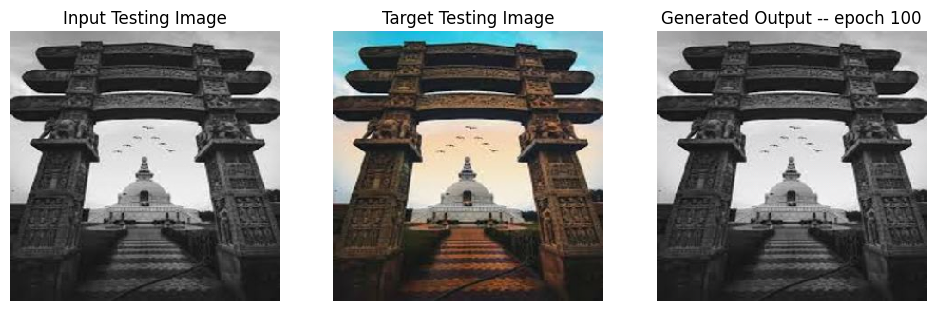

SSIM Score: 0.9550855755805969
PSNR Score: 22.592496871948242
LPIPS Score: 0.9531096816062927


In [42]:
display_random_test_image(test_dataset , gen,100)

In [43]:
import random
from tqdm import tqdm

each_epoch_train_generator_losses = []
each_epoch_train_generator_gan_losses = []
each_epoch_train_generator_l1_losses = []
each_epoch_train_generator_l2_losses = []
each_epoch_train_generator_perceptual_losses = []
each_epoch_train_discriminator_losses = []
each_epoch_train_discriminator_real_losses = []
each_epoch_train_discriminator_generated_losses = []
each_epoch_train_ssim = []
each_epoch_train_psnr = []
each_epoch_train_lpips = []
each_epoch_test_lpips = []
each_epoch_test_psnr = []
each_epoch_test_ssim = []
each_epoch_test_generator_losses = []
each_epoch_test_generator_gan_losses = []
each_epoch_test_generator_l1_losses = []
each_epoch_test_generator_l2_losses = []
each_epoch_test_generator_perceptual_losses = []
each_epoch_test_discriminator_losses = []
each_epoch_test_discriminator_real_losses = []
each_epoch_test_discriminator_generated_losses = []
train_generator_losses = []
train_generator_gan_losses = []
train_generator_l1_losses = []
train_generator_l2_losses = []
train_generator_perceptual_losses = []
train_discriminator_losses = []
train_discriminator_real_losses = []
train_discriminator_generated_losses = []
test_generator_losses = []
test_generator_gan_losses = []
test_generator_l1_losses = []
test_generator_l2_losses = []
test_generator_perceptual_losses = []
test_discriminator_losses = []
test_discriminator_real_losses = []
test_discriminator_generated_losses =[]
training_ssim = []
training_psnr = []
training_lpips = []
testing_ssim = []
testing_psnr = []
testing_lpips = []
each_epoch_all_records = []
all_records = []
def fit(train_ds, epochs, test_ds, gen_model):
    time_start = time.time()
    # Declare global lists
    global each_epoch_train_generator_losses, each_epoch_train_generator_gan_losses, each_epoch_train_generator_l1_losses, each_epoch_train_generator_l2_losses, each_epoch_train_generator_perceptual_losses, each_epoch_train_discriminator_losses,each_epoch_train_discriminator_real_losses, each_epoch_train_discriminator_generated_losses, each_epoch_train_ssim, each_epoch_train_psnr
    global each_epoch_test_psnr, each_epoch_test_ssim, each_epoch_test_generator_losses, each_epoch_test_generator_gan_losses, each_epoch_test_generator_l1_losses, each_epoch_test_generator_l2_losses, each_epoch_test_generator_perceptual_losses, each_epoch_test_discriminator_losses, each_epoch_test_discriminator_real_losses, each_epoch_test_discriminator_generated_losses
    global train_generator_losses, train_generator_gan_losses, train_generator_l1_losses, train_generator_l2_losses, train_generator_perceptual_losses, train_discriminator_losses, train_discriminator_real_losses, train_discriminator_generated_losses, test_generator_losses, test_generator_l2_losses, test_generator_gan_losses, test_generator_l1_losses, test_generator_perceptual_losses, test_discriminator_losses, test_discriminator_real_losses, test_discriminator_generated_losses
    global training_ssim, training_psnr, testing_ssim, testing_psnr, each_epoch_all_records, all_records, LAMBDA, each_epoch_train_lpips, each_epoch_test_lpips, training_lpips, testing_lpips


    # Initialize counters and flags
    consecutive_epochs_high_loss = 0
    training_discriminator = True
    stop_training = False
    min_learning_rate = 1e-7  # Set your desired minimum learning rate

    for epoch in range(epochs):
        start = time.time()
        train_count = 0
        test_count = 0
        
        # Initialize tqdm to track progress
#         progress_bar_train = tqdm(total=len(train_ds), desc=f'Epoch {epoch + 1}/{epochs}', unit='batches')
#         progress_bar_test = tqdm(total=len(test_ds), desc=f'Epoch {epoch + 1}/{epochs}', unit='batches')

        
        print(f"Epoch {epoch}")

        for n, (input_, target) in train_ds.enumerate():
            train_gen_loss, train_gen_gan_loss, train_gen_l1_loss,train_gen_l2_loss, train_gen_perceptual_loss, train_disc_loss, train_disc_real_loss, train_disc_generated_loss, train_ssim, train_psnr, train_lpips = train_step(input_, target, epoch, training_discriminator=training_discriminator)

            each_epoch_train_generator_losses.append(train_gen_loss)
            each_epoch_train_generator_gan_losses.append(train_gen_gan_loss)
            each_epoch_train_generator_l1_losses.append(train_gen_l1_loss)
            each_epoch_train_generator_l2_losses.append(train_gen_l2_loss)
            each_epoch_train_generator_perceptual_losses.append(train_gen_perceptual_loss)
            each_epoch_train_discriminator_losses.append(train_disc_loss)
            each_epoch_train_discriminator_real_losses.append(train_disc_real_loss)
            each_epoch_train_discriminator_generated_losses.append(train_disc_generated_loss)
            each_epoch_train_ssim.append(tf.reduce_mean(train_ssim.numpy()))
            each_epoch_train_psnr.append(tf.reduce_mean(train_psnr.numpy()))
            each_epoch_train_lpips.append(tf.reduce_mean(train_lpips.numpy()))
            train_count += 1
            
#             progress_bar_train.update(1)

        #each_epoch_train_generator_losses = np.array(each_epoch_train_generator_losses)
        #print(each_epoch_train_discriminator_losses.shape())
        #print(each_epoch_train_generator_losses.shape())
        #print(each_epoch_train_ssim())
        print("Training Details")
        print("Generator-- total_loss:{:.2f} gan_loss:{:.2f} l1_loss:{:.2f} l2_loss:{:.2f} perceptual_loss:{:.2f} Discriminator-- total_loss:{:.2f} real_loss:{:.2f} generated_loss:{:.2f} --- SSIM {:.2f} PSNR {:.2f} LPIPS {:.2f}".format(np.mean(each_epoch_train_generator_losses),np.mean(each_epoch_train_generator_gan_losses), np.mean(each_epoch_train_generator_l1_losses),np.mean(each_epoch_train_generator_l2_losses),np.mean(each_epoch_train_generator_perceptual_losses), np.mean(each_epoch_train_discriminator_losses), np.mean(each_epoch_train_discriminator_generated_losses), np.mean(each_epoch_train_discriminator_real_losses), np.mean(each_epoch_train_ssim), np.mean(each_epoch_train_psnr), np.mean(each_epoch_train_lpips)))
        print("Time taken for epoch {} is {} sec".format(epoch + 1, time.time() - start))
        print(f"Number of iteration {train_count}")
#         progress_bar_train.close()
        train_generator_losses.append(np.mean(each_epoch_train_generator_losses))
        train_generator_gan_losses.append(np.mean(each_epoch_train_generator_gan_losses))
        train_generator_l1_losses.append(np.mean(each_epoch_train_generator_l1_losses))
        train_generator_l2_losses.append(np.mean(each_epoch_train_generator_l2_losses))
        train_generator_perceptual_losses.append(np.mean(each_epoch_train_generator_perceptual_losses))
        train_discriminator_losses.append(np.mean(each_epoch_train_discriminator_losses))
        train_discriminator_real_losses.append(np.mean(each_epoch_train_discriminator_real_losses))
        train_discriminator_generated_losses.append(np.mean(each_epoch_train_discriminator_generated_losses))
        training_ssim.append(np.mean(each_epoch_train_ssim))
        training_psnr.append(np.mean(each_epoch_train_psnr))
        training_lpips.append(np.mean(each_epoch_train_lpips))
        # Test
        for n, (input_, target) in test_ds.enumerate():
            test_gen_loss, test_gen_gan_loss, test_gen_l1_loss,test_gen_l2_loss, test_gen_perceptual_loss, test_disc_loss, test_disc_real_loss, test_disc_generated_loss, test_ssim, test_psnr, test_lpips = test_step(input_, target)
            test_count += 1

            each_epoch_test_generator_losses.append(test_gen_loss)
            each_epoch_test_generator_gan_losses.append(test_gen_gan_loss)
            each_epoch_test_generator_l1_losses.append(test_gen_l1_loss)
            each_epoch_test_generator_l2_losses.append(test_gen_l2_loss)
            each_epoch_test_generator_perceptual_losses.append(test_gen_perceptual_loss)
            each_epoch_test_discriminator_losses.append(test_disc_loss)
            each_epoch_test_discriminator_real_losses.append(test_disc_real_loss)
            each_epoch_test_discriminator_generated_losses.append(test_disc_generated_loss)
            each_epoch_test_ssim.append(tf.reduce_mean(test_ssim.numpy()))
            each_epoch_test_psnr.append(tf.reduce_mean(test_psnr.numpy()))
            each_epoch_test_lpips.append(tf.reduce_mean(test_lpips.numpy()))
#             progress_bar_test.update(1)

        print("Testing Details")
        print("Generator-- total_loss:{:.2f} gan_loss:{:.2f} l1_loss:{:.2f} l2_loss:{:.2f} perceptual_loss:{:.2f} Discriminator-- total_loss:{:.2f} real_loss:{:.2f} generated_loss:{:.2f} --- SSIM {:.2f} PSNR {:.2f} LPIPS {:.2f}".format(np.mean(each_epoch_test_generator_losses),np.mean(each_epoch_test_generator_gan_losses), np.mean(each_epoch_test_generator_l1_losses),np.mean(each_epoch_test_generator_l2_losses), np.mean(each_epoch_test_generator_perceptual_losses),np.mean(each_epoch_test_discriminator_losses), np.mean(each_epoch_test_discriminator_generated_losses), np.mean(each_epoch_test_discriminator_real_losses), np.mean(each_epoch_test_ssim), np.mean(each_epoch_test_psnr), np.mean(each_epoch_test_lpips)))
        print("Time taken for epoch {} is {} sec".format(epoch+1, time.time() - start))
        print(f"Number of iteration {test_count}")
#         progress_bar_test.close()
#         LAMBDA = LAMBDA * 1.006
        test_generator_losses.append(np.mean(each_epoch_test_generator_losses))
        test_generator_gan_losses.append(np.mean(each_epoch_test_generator_gan_losses))
        test_generator_l1_losses.append(np.mean(each_epoch_test_generator_l1_losses))
        test_generator_l2_losses.append(np.mean(each_epoch_test_generator_l2_losses))
        test_generator_perceptual_losses.append(np.mean(each_epoch_test_generator_perceptual_losses))
        test_discriminator_losses.append(np.mean(each_epoch_test_discriminator_losses))
        test_discriminator_real_losses.append(np.mean(each_epoch_test_discriminator_real_losses))
        test_discriminator_generated_losses.append(np.mean(each_epoch_test_discriminator_generated_losses))
        testing_ssim.append(np.mean(each_epoch_test_ssim))
        testing_psnr.append(np.mean(each_epoch_test_psnr))
        testing_lpips.append(np.mean(each_epoch_test_lpips))
        each_epoch_all_records.append([np.mean(each_epoch_train_generator_losses),np.mean(each_epoch_train_generator_gan_losses), np.mean(each_epoch_train_generator_l1_losses),np.mean(each_epoch_train_generator_l2_losses),np.mean(each_epoch_train_generator_perceptual_losses), np.mean(each_epoch_train_discriminator_losses), np.mean(each_epoch_train_discriminator_generated_losses), np.mean(each_epoch_train_discriminator_real_losses), np.mean(each_epoch_train_ssim), np.mean(each_epoch_train_psnr),np.mean(each_epoch_train_lpips), np.mean(each_epoch_test_generator_losses),np.mean(each_epoch_test_generator_gan_losses), np.mean(each_epoch_test_generator_l1_losses),np.mean(each_epoch_test_generator_l2_losses), np.mean(each_epoch_test_generator_perceptual_losses),np.mean(each_epoch_test_discriminator_losses), np.mean(each_epoch_test_discriminator_generated_losses), np.mean(each_epoch_test_discriminator_real_losses), np.mean(each_epoch_test_ssim), np.mean(each_epoch_test_psnr), np.mean(each_epoch_test_lpips)])
        all_records.append(each_epoch_all_records)
        # emptying for next epoch
        each_epoch_test_ssim = []
        each_epoch_test_generator_losses = []
        each_epoch_test_generator_gan_losses = []
        each_epoch_test_generator_l1_losses = []
        each_epoch_test_generator_l2_losses = []
        each_epoch_test_generator_perceptual_losses = []
        each_epoch_test_discriminator_losses = []
        each_epoch_test_discriminator_real_losses = []
        each_epoch_test_discriminator_generated_losses = []
        each_epoch_test_psnr = []
        each_epoch_test_lpips = []
        each_epoch_all_records = []
        #emptyling list for next iteration
        each_epoch_train_generator_losses = []
        each_epoch_train_generator_gan_losses = []
        each_epoch_train_generator_l1_losses = []
        each_epoch_train_generator_l2_losses = []
        each_epoch_train_generator_perceptual_losses = []
        each_epoch_train_discriminator_losses = []
        each_epoch_train_discriminator_real_losses = []
        each_epoch_train_discriminator_generated_losses = []
        each_epoch_train_ssim = []
        each_epoch_train_psnr = []
        each_epoch_train_lpips = []
        if epoch == 0 or epoch % 3 == 0:
            # Function to display one random test image
            # def display_random_test_image(images, labels, gen_model):
            #     # Randomly select an index
            #     random_test_image_idx = random.randint(0, len(images) - 1)

            #     # Extract input and target from the selected index
            #     random_test_input = images[random_test_image_idx]
            #     random_test_target = labels[random_test_image_idx]

            #     # Display the image
            #     display_one_random_test_image(random_test_input, random_test_target, gen_model)

            # Example usage
            display_random_test_image(test_ds, gen_model, epoch+1)
        # Check if the difference between two consecutive epochs for the last 5 epochs is less than 1
        if epoch > 10:
            # Check 1f the difference between two consecutive epochs for the last S epochs is less than 1 or 0.3
            last_epochs_losses = train_discriminator_losses[-5:] if training_discriminator else train_generator_losses[-5:]
            if all(((last_epochs_losses[i] - last_epochs_losses[i - 1])) < 0.01 if training_discriminator else ((last_epochs_losses[1] - last_epochs_losses[i - 1])) < 0.05 for i in range(1, 5)):
                consecutive_epochs_high_loss += 1
            else:
                consecutive_epochs_high_loss = 0
        


#         LAMBDA = LAMBDA*1.003
            # If the condition is met for 3 consecutive epochs, reduce the learning rate
        if time.time() - time_start > 41000:
            stop_training = True
        if consecutive_epochs_high_loss == 3:
            if training_discriminator:
                current_lr = generator_optimizer. learning_rate.numpy()
                new_lr = max (current_lr * 0.5, min_learning_rate)
                if new_lr > min_learning_rate:
                    generator_optimizer.learning_rate.assign(new_lr)
                    print (f"Reduced generator learning rate to {new_lr} at epoch {epoch + 1}")
                    # Switch training focus
                    training_discriminator = not training_discriminator
                else:
                    print(f"Generator learning rate already at the minimum. Stopping training.")
                    stop_training = True
            else:
                current_lr = discriminator_optimizer.learning_rate.numpy()
                new_lr = max (current_lr * 0.3, min_learning_rate)
                if new_lr > min_learning_rate:
                    discriminator_optimizer.learning_rate.assign(new_lr)
                    print(f"Reduced discriminator learning rate to {new_lr} at epoch {epoch + 1}.")
                    # Switch training focus
                    training_discriminator = not training_discriminator
                else:
                    print(f"Discriminator learning rate already at the minimum. Stopping training.")
                    stop_training = True

                consecutive_epochs_high_loss = 0

        # Check the flag variable
        if stop_training:
            break

In [44]:
tf.config.run_functions_eagerly(True)

Epoch 0
Training Details
Generator-- total_loss:16.84 gan_loss:10.13 l1_loss:0.08 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.03 real_loss:0.01 generated_loss:0.02 --- SSIM 0.45 PSNR 17.31 LPIPS 2.06
Time taken for epoch 1 is 136.89565634727478 sec
Number of iteration 490
Testing Details
Generator-- total_loss:4.41 gan_loss:0.00 l1_loss:0.06 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:12.63 real_loss:12.57 generated_loss:0.06 --- SSIM 0.82 PSNR 21.69 LPIPS 1.18
Time taken for epoch 1 is 162.6943073272705 sec
Number of iteration 140
Displaying one random test image...


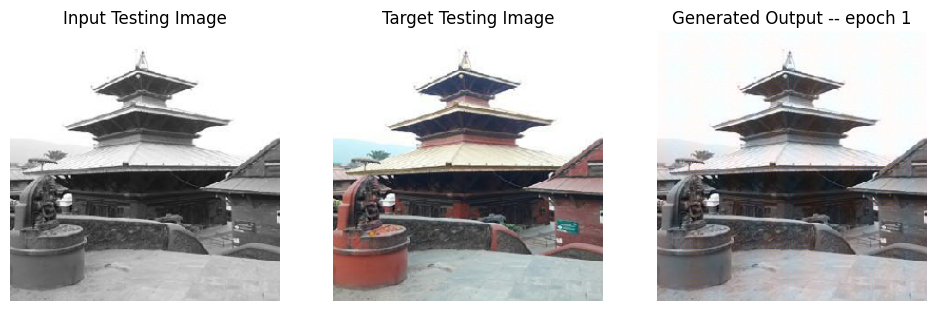

SSIM Score: 0.7796618938446045
PSNR Score: 26.356687545776367
LPIPS Score: 0.6264036297798157
Epoch 1
Training Details
Generator-- total_loss:19.32 gan_loss:12.61 l1_loss:0.08 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.45 PSNR 17.31 LPIPS 2.06
Time taken for epoch 2 is 135.3677694797516 sec
Number of iteration 490
Testing Details
Generator-- total_loss:5.51 gan_loss:0.00 l1_loss:0.07 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:16.88 real_loss:16.87 generated_loss:0.01 --- SSIM 0.61 PSNR 19.40 LPIPS 1.42
Time taken for epoch 2 is 160.86778950691223 sec
Number of iteration 140
Epoch 2
Training Details
Generator-- total_loss:20.86 gan_loss:14.15 l1_loss:0.08 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.45 PSNR 17.30 LPIPS 2.06
Time taken for epoch 3 is 133.0874559879303 sec
Number of iteration 490
Testing Details
Generator-- total_loss:5.

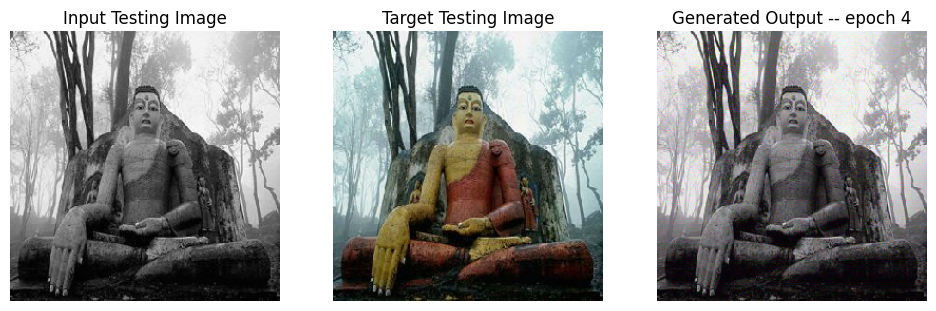

SSIM Score: 0.6336986422538757
PSNR Score: 20.665695190429688
LPIPS Score: 1.0713282823562622
Epoch 4
Training Details
Generator-- total_loss:22.18 gan_loss:15.47 l1_loss:0.08 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.45 PSNR 17.31 LPIPS 2.06
Time taken for epoch 5 is 135.05260109901428 sec
Number of iteration 490
Testing Details
Generator-- total_loss:5.60 gan_loss:0.00 l1_loss:0.07 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:19.80 real_loss:19.79 generated_loss:0.01 --- SSIM 0.60 PSNR 19.24 LPIPS 1.45
Time taken for epoch 5 is 160.7658498287201 sec
Number of iteration 140
Epoch 5
Training Details
Generator-- total_loss:22.72 gan_loss:16.02 l1_loss:0.08 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.45 PSNR 17.31 LPIPS 2.06
Time taken for epoch 6 is 134.62803745269775 sec
Number of iteration 490
Testing Details
Generator-- total_loss:5

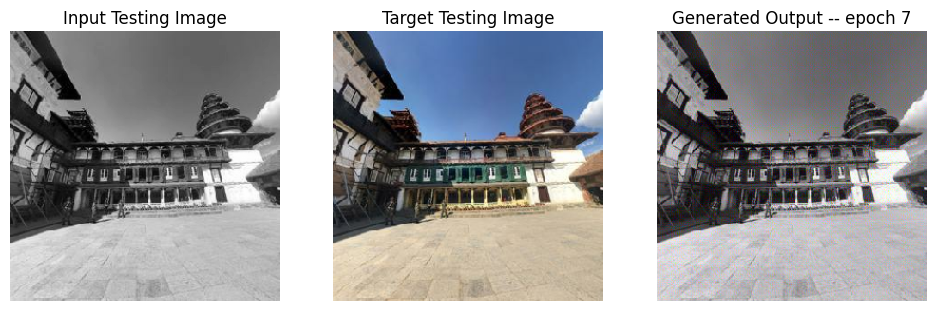

SSIM Score: 0.5326258540153503
PSNR Score: 18.77706527709961
LPIPS Score: 1.0919992923736572
Epoch 7
Training Details
Generator-- total_loss:23.45 gan_loss:16.74 l1_loss:0.08 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.45 PSNR 17.30 LPIPS 2.06
Time taken for epoch 8 is 134.0161154270172 sec
Number of iteration 490
Testing Details
Generator-- total_loss:5.59 gan_loss:0.00 l1_loss:0.07 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:21.01 real_loss:21.01 generated_loss:0.00 --- SSIM 0.60 PSNR 19.25 LPIPS 1.45
Time taken for epoch 8 is 159.6088786125183 sec
Number of iteration 140
Epoch 8
Training Details
Generator-- total_loss:23.80 gan_loss:17.09 l1_loss:0.08 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.45 PSNR 17.30 LPIPS 2.06
Time taken for epoch 9 is 135.60328364372253 sec
Number of iteration 490
Testing Details
Generator-- total_loss:5.6

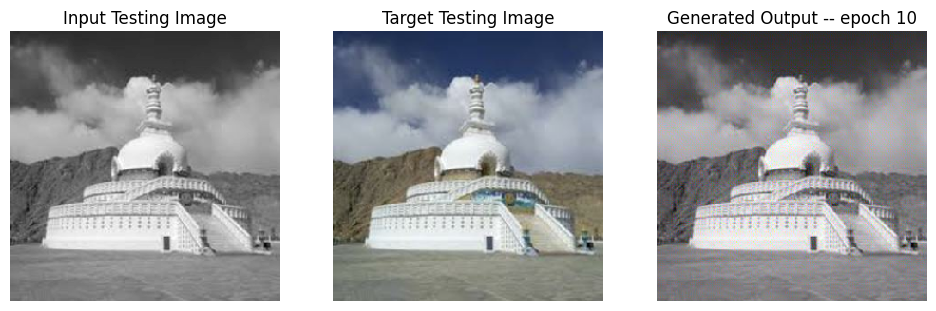

SSIM Score: 0.5162132382392883
PSNR Score: 22.231630325317383
LPIPS Score: 0.5468704700469971
Epoch 10
Training Details
Generator-- total_loss:24.63 gan_loss:17.92 l1_loss:0.08 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.45 PSNR 17.31 LPIPS 2.06
Time taken for epoch 11 is 133.9261031150818 sec
Number of iteration 490
Testing Details
Generator-- total_loss:5.60 gan_loss:0.00 l1_loss:0.07 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:22.22 real_loss:22.21 generated_loss:0.01 --- SSIM 0.60 PSNR 19.25 LPIPS 1.45
Time taken for epoch 11 is 159.487202167511 sec
Number of iteration 140
Epoch 11
Training Details
Generator-- total_loss:24.93 gan_loss:18.22 l1_loss:0.08 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.45 PSNR 17.30 LPIPS 2.06
Time taken for epoch 12 is 133.91037893295288 sec
Number of iteration 490
Testing Details
Generator-- total_los

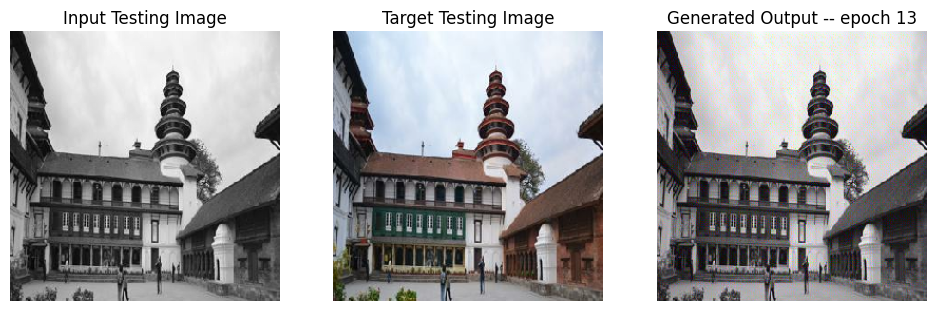

SSIM Score: 0.529646635055542
PSNR Score: 20.976394653320312
LPIPS Score: 1.0607551336288452
Epoch 13
Training Details
Generator-- total_loss:25.63 gan_loss:18.93 l1_loss:0.08 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.45 PSNR 17.30 LPIPS 2.06
Time taken for epoch 14 is 135.88120985031128 sec
Number of iteration 490
Testing Details
Generator-- total_loss:5.60 gan_loss:0.00 l1_loss:0.07 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:22.96 real_loss:22.94 generated_loss:0.02 --- SSIM 0.60 PSNR 19.24 LPIPS 1.45
Time taken for epoch 14 is 161.49230813980103 sec
Number of iteration 140
Reduced generator learning rate to 0.0005000000237487257 at epoch 14
Epoch 14
Training Details
Generator-- total_loss:3.26 gan_loss:0.09 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:23.18 real_loss:23.18 generated_loss:0.00 --- SSIM 0.90 PSNR 23.98 LPIPS 1.08
Time taken for epoch 15 is 162.149131536

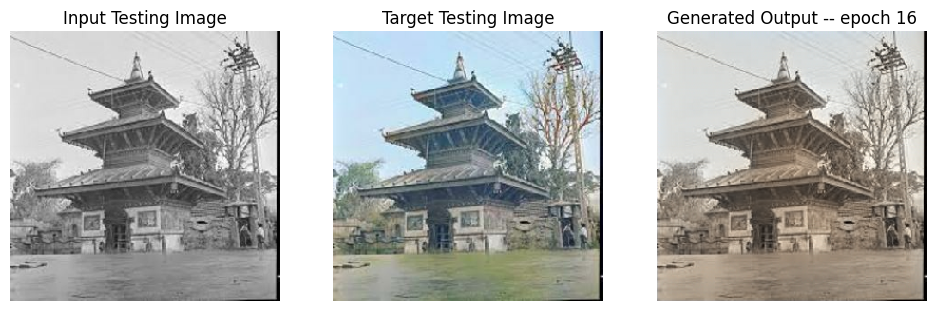

SSIM Score: 0.9808516502380371
PSNR Score: 24.336523056030273
LPIPS Score: 0.32388344407081604
Epoch 16
Training Details
Generator-- total_loss:2.70 gan_loss:0.00 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:23.53 real_loss:23.53 generated_loss:0.00 --- SSIM 0.95 PSNR 25.16 LPIPS 0.95
Time taken for epoch 17 is 163.45879006385803 sec
Number of iteration 490
Testing Details
Generator-- total_loss:3.97 gan_loss:0.00 l1_loss:0.05 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:21.82 real_loss:21.82 generated_loss:0.00 --- SSIM 0.94 PSNR 22.28 LPIPS 1.10
Time taken for epoch 17 is 189.0316104888916 sec
Number of iteration 140
Epoch 17
Training Details
Generator-- total_loss:2.67 gan_loss:0.00 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:23.43 real_loss:23.43 generated_loss:0.00 --- SSIM 0.95 PSNR 25.23 LPIPS 0.94
Time taken for epoch 18 is 162.98881888389587 sec
Number of iteration 490
Testing Details
Generator-- total_

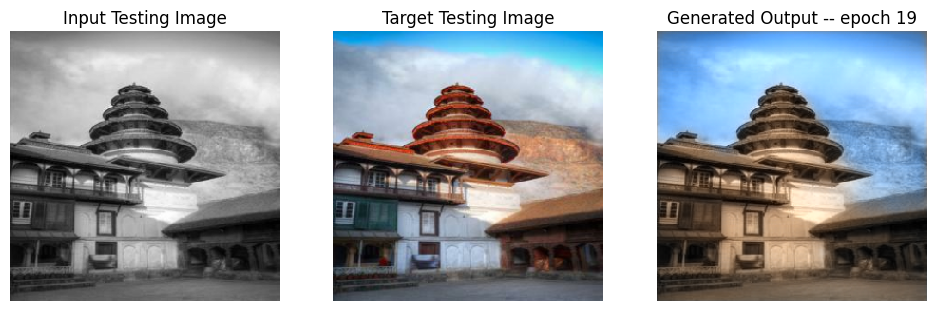

SSIM Score: 0.9225450158119202
PSNR Score: 18.38045883178711
LPIPS Score: 1.038029670715332
Epoch 19
Training Details
Generator-- total_loss:2.61 gan_loss:0.00 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:23.37 real_loss:23.37 generated_loss:0.00 --- SSIM 0.96 PSNR 25.40 LPIPS 0.92
Time taken for epoch 20 is 162.1830506324768 sec
Number of iteration 490
Testing Details
Generator-- total_loss:3.03 gan_loss:0.00 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:20.42 real_loss:20.42 generated_loss:0.00 --- SSIM 0.95 PSNR 24.63 LPIPS 0.99
Time taken for epoch 20 is 187.80301189422607 sec
Number of iteration 140
Epoch 20
Training Details
Generator-- total_loss:2.59 gan_loss:0.00 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:23.33 real_loss:23.33 generated_loss:0.00 --- SSIM 0.96 PSNR 25.46 LPIPS 0.91
Time taken for epoch 21 is 163.19731450080872 sec
Number of iteration 490
Testing Details
Generator-- total_los

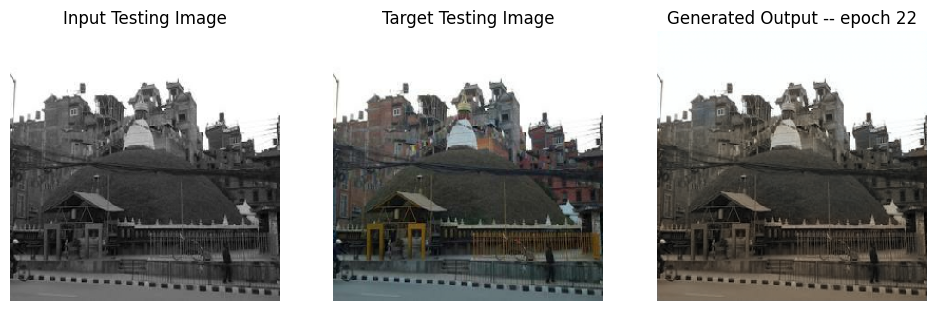

SSIM Score: 0.9837854504585266
PSNR Score: 30.05252456665039
LPIPS Score: 0.3300982713699341
Epoch 22
Training Details
Generator-- total_loss:2.57 gan_loss:0.00 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:23.33 real_loss:23.33 generated_loss:0.00 --- SSIM 0.96 PSNR 25.55 LPIPS 0.90
Time taken for epoch 23 is 164.34847807884216 sec
Number of iteration 490
Testing Details
Generator-- total_loss:3.19 gan_loss:0.00 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:22.43 real_loss:22.43 generated_loss:0.00 --- SSIM 0.95 PSNR 24.18 LPIPS 1.02
Time taken for epoch 23 is 190.14327430725098 sec
Number of iteration 140
Epoch 23
Training Details
Generator-- total_loss:2.55 gan_loss:0.00 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:23.30 real_loss:23.30 generated_loss:0.00 --- SSIM 0.96 PSNR 25.56 LPIPS 0.90
Time taken for epoch 24 is 163.73879075050354 sec
Number of iteration 490
Testing Details
Generator-- total_l

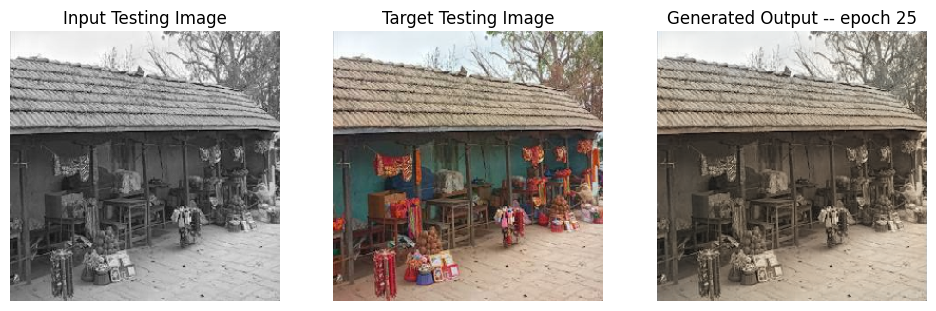

SSIM Score: 0.9635154604911804
PSNR Score: 26.66838264465332
LPIPS Score: 1.1036854982376099
Epoch 25
Training Details
Generator-- total_loss:10.28 gan_loss:7.70 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 25.50 LPIPS 0.90
Time taken for epoch 26 is 134.235271692276 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.95 gan_loss:0.00 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:6.72 real_loss:6.71 generated_loss:0.01 --- SSIM 0.95 PSNR 24.86 LPIPS 0.96
Time taken for epoch 26 is 159.9203290939331 sec
Number of iteration 140
Epoch 26
Training Details
Generator-- total_loss:11.81 gan_loss:9.23 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 25.48 LPIPS 0.90
Time taken for epoch 27 is 135.57255792617798 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.9

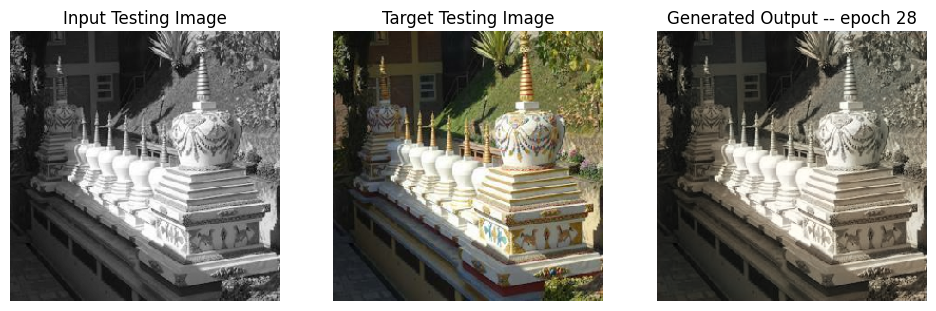

SSIM Score: 0.9681458473205566
PSNR Score: 26.982736587524414
LPIPS Score: 0.9759296178817749
Epoch 28
Training Details
Generator-- total_loss:2.53 gan_loss:0.01 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:11.22 real_loss:11.22 generated_loss:0.00 --- SSIM 0.96 PSNR 25.63 LPIPS 0.89
Time taken for epoch 29 is 162.83564376831055 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.86 gan_loss:0.00 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:12.32 real_loss:12.31 generated_loss:0.00 --- SSIM 0.95 PSNR 25.02 LPIPS 0.95
Time taken for epoch 29 is 188.3476550579071 sec
Number of iteration 140
Epoch 29
Training Details
Generator-- total_loss:2.52 gan_loss:0.00 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:11.01 real_loss:11.01 generated_loss:0.00 --- SSIM 0.96 PSNR 25.63 LPIPS 0.89
Time taken for epoch 30 is 163.20351266860962 sec
Number of iteration 490
Testing Details
Generator-- total_l

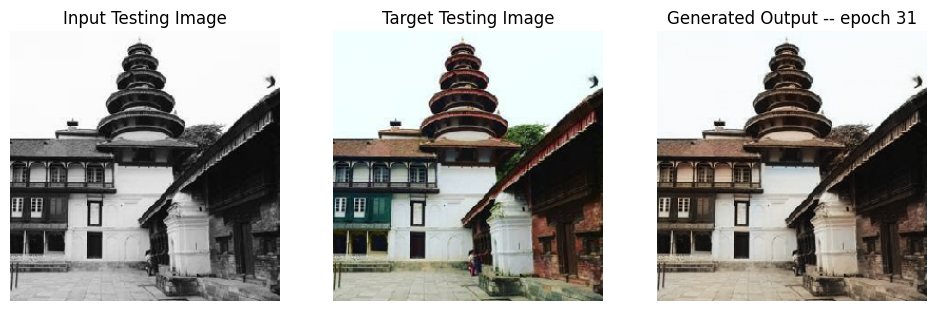

SSIM Score: 0.9808822274208069
PSNR Score: 29.678955078125
LPIPS Score: 0.4911845326423645
Epoch 31
Training Details
Generator-- total_loss:2.49 gan_loss:0.00 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:10.81 real_loss:10.81 generated_loss:0.00 --- SSIM 0.96 PSNR 25.73 LPIPS 0.88
Time taken for epoch 32 is 162.95793271064758 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.95 gan_loss:0.00 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:11.91 real_loss:11.91 generated_loss:0.00 --- SSIM 0.95 PSNR 24.85 LPIPS 0.96
Time taken for epoch 32 is 188.61896753311157 sec
Number of iteration 140
Epoch 32
Training Details
Generator-- total_loss:2.49 gan_loss:0.00 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:10.85 real_loss:10.85 generated_loss:0.00 --- SSIM 0.96 PSNR 25.73 LPIPS 0.88
Time taken for epoch 33 is 162.8663969039917 sec
Number of iteration 490
Testing Details
Generator-- total_loss

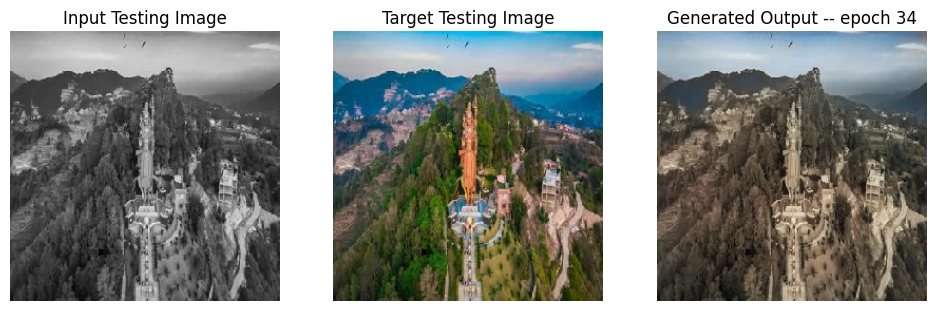

SSIM Score: 0.9104616641998291
PSNR Score: 21.527263641357422
LPIPS Score: 1.6287431716918945
Epoch 34
Training Details
Generator-- total_loss:9.79 gan_loss:7.30 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.05 real_loss:0.02 generated_loss:0.02 --- SSIM 0.96 PSNR 25.74 LPIPS 0.88
Time taken for epoch 35 is 135.54405736923218 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.88 gan_loss:0.04 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:4.50 real_loss:4.42 generated_loss:0.08 --- SSIM 0.95 PSNR 25.11 LPIPS 0.94
Time taken for epoch 35 is 161.16406273841858 sec
Number of iteration 140
Epoch 35
Training Details
Generator-- total_loss:10.61 gan_loss:8.12 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.02 real_loss:0.01 generated_loss:0.01 --- SSIM 0.96 PSNR 25.73 LPIPS 0.88
Time taken for epoch 36 is 134.25633454322815 sec
Number of iteration 490
Testing Details
Generator-- total_loss:

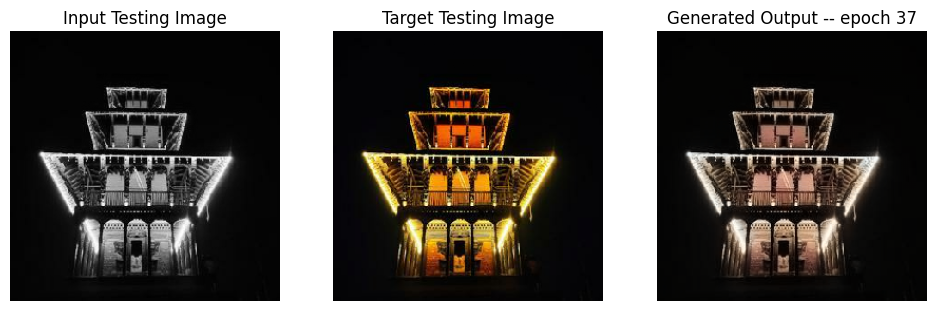

SSIM Score: 0.9255191683769226
PSNR Score: 23.149425506591797
LPIPS Score: 1.2210098505020142
Epoch 37
Training Details
Generator-- total_loss:11.76 gan_loss:9.28 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 25.76 LPIPS 0.88
Time taken for epoch 38 is 133.8283896446228 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.84 gan_loss:0.01 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:6.60 real_loss:6.57 generated_loss:0.03 --- SSIM 0.95 PSNR 25.10 LPIPS 0.94
Time taken for epoch 38 is 159.29329776763916 sec
Number of iteration 140
Epoch 38
Training Details
Generator-- total_loss:12.17 gan_loss:9.68 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.02 real_loss:0.01 generated_loss:0.01 --- SSIM 0.96 PSNR 25.73 LPIPS 0.88
Time taken for epoch 39 is 133.76369738578796 sec
Number of iteration 490
Testing Details
Generator-- total_loss:

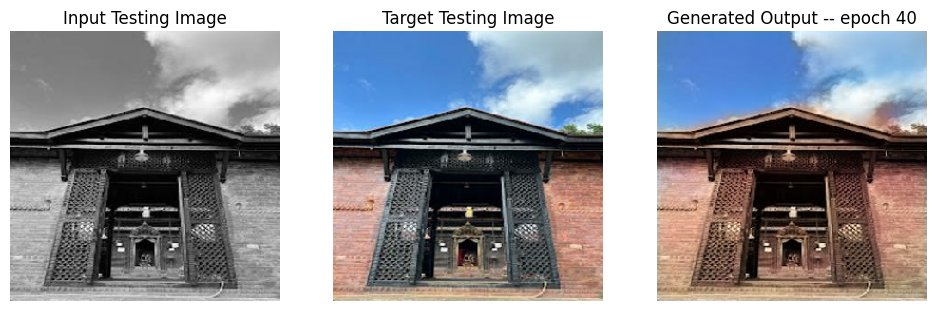

SSIM Score: 0.9369321465492249
PSNR Score: 24.12755584716797
LPIPS Score: 0.6171749234199524
Epoch 40
Training Details
Generator-- total_loss:12.42 gan_loss:9.94 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 25.74 LPIPS 0.88
Time taken for epoch 41 is 134.60806798934937 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.84 gan_loss:0.01 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:7.58 real_loss:7.56 generated_loss:0.02 --- SSIM 0.95 PSNR 25.10 LPIPS 0.94
Time taken for epoch 41 is 159.90063643455505 sec
Number of iteration 140
Epoch 41
Training Details
Generator-- total_loss:13.20 gan_loss:10.72 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.02 real_loss:0.01 generated_loss:0.01 --- SSIM 0.96 PSNR 25.73 LPIPS 0.88
Time taken for epoch 42 is 132.8400959968567 sec
Number of iteration 490
Testing Details
Generator-- total_loss:

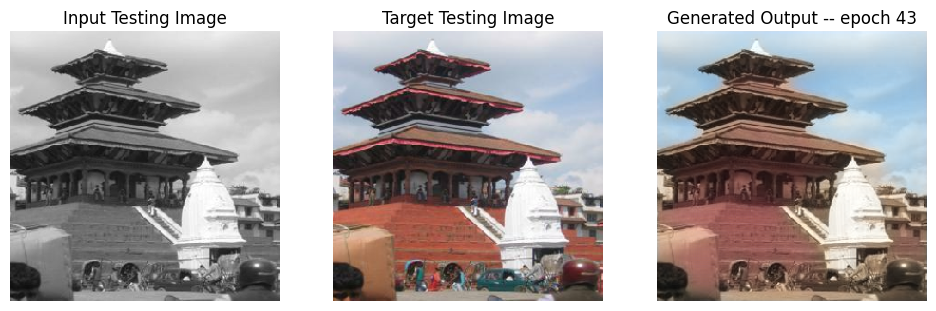

SSIM Score: 0.9574406147003174
PSNR Score: 26.56620216369629
LPIPS Score: 0.8029325008392334
Epoch 43
Training Details
Generator-- total_loss:14.38 gan_loss:11.90 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.01 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 25.75 LPIPS 0.88
Time taken for epoch 44 is 136.66219305992126 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.84 gan_loss:0.01 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:7.22 real_loss:7.19 generated_loss:0.03 --- SSIM 0.95 PSNR 25.10 LPIPS 0.94
Time taken for epoch 44 is 162.57982349395752 sec
Number of iteration 140
Epoch 44
Training Details
Generator-- total_loss:12.51 gan_loss:10.02 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.04 real_loss:0.02 generated_loss:0.02 --- SSIM 0.96 PSNR 25.74 LPIPS 0.88
Time taken for epoch 45 is 138.8072988986969 sec
Number of iteration 490
Testing Details
Generator-- total_loss

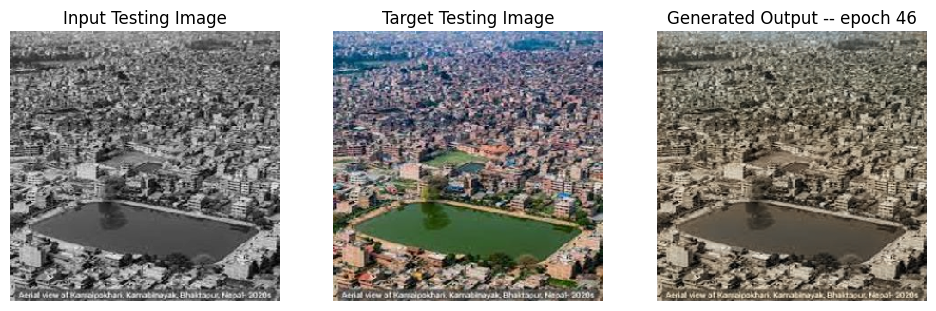

SSIM Score: 0.9716382026672363
PSNR Score: 23.532047271728516
LPIPS Score: 1.1434047222137451
Epoch 46
Training Details
Generator-- total_loss:13.63 gan_loss:11.14 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 25.74 LPIPS 0.88
Time taken for epoch 47 is 137.17032551765442 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.84 gan_loss:0.01 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:8.03 real_loss:8.01 generated_loss:0.02 --- SSIM 0.95 PSNR 25.11 LPIPS 0.94
Time taken for epoch 47 is 163.34087705612183 sec
Number of iteration 140
Epoch 47
Training Details
Generator-- total_loss:13.65 gan_loss:11.16 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 25.74 LPIPS 0.88
Time taken for epoch 48 is 138.53099250793457 sec
Number of iteration 490
Testing Details
Generator-- total_lo

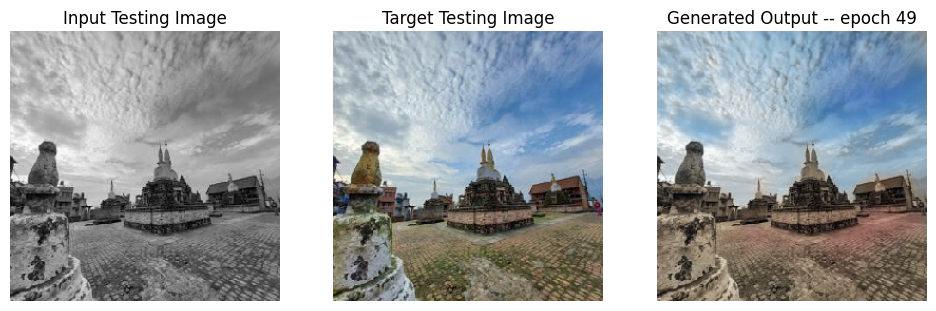

SSIM Score: 0.9806632995605469
PSNR Score: 29.634021759033203
LPIPS Score: 0.42363107204437256
Epoch 49
Training Details
Generator-- total_loss:11.46 gan_loss:8.98 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 25.76 LPIPS 0.88
Time taken for epoch 50 is 137.3387475013733 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.84 gan_loss:0.01 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:6.41 real_loss:6.39 generated_loss:0.02 --- SSIM 0.95 PSNR 25.11 LPIPS 0.94
Time taken for epoch 50 is 163.44451546669006 sec
Number of iteration 140
Epoch 50
Training Details
Generator-- total_loss:12.37 gan_loss:9.89 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 25.74 LPIPS 0.88
Time taken for epoch 51 is 136.68134355545044 sec
Number of iteration 490
Testing Details
Generator-- total_loss

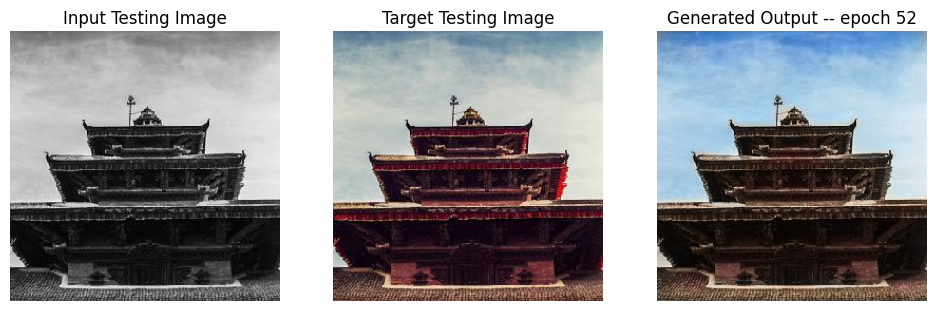

SSIM Score: 0.9447982907295227
PSNR Score: 23.011104583740234
LPIPS Score: 0.707435131072998
Epoch 52
Training Details
Generator-- total_loss:14.34 gan_loss:11.85 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 25.74 LPIPS 0.88
Time taken for epoch 53 is 137.65621614456177 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.84 gan_loss:0.01 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:7.08 real_loss:7.07 generated_loss:0.01 --- SSIM 0.95 PSNR 25.11 LPIPS 0.94
Time taken for epoch 53 is 163.60210537910461 sec
Number of iteration 140
Epoch 53
Training Details
Generator-- total_loss:14.60 gan_loss:12.12 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 25.74 LPIPS 0.88
Time taken for epoch 54 is 135.9810814857483 sec
Number of iteration 490
Testing Details
Generator-- total_loss

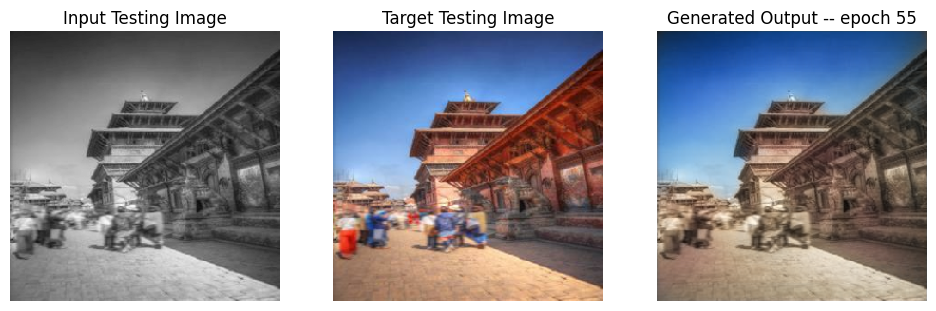

SSIM Score: 0.9352279305458069
PSNR Score: 22.972705841064453
LPIPS Score: 0.9147624373435974
Epoch 55
Training Details
Generator-- total_loss:14.63 gan_loss:12.14 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 25.75 LPIPS 0.88
Time taken for epoch 56 is 138.88144731521606 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.84 gan_loss:0.01 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:7.17 real_loss:7.16 generated_loss:0.01 --- SSIM 0.95 PSNR 25.10 LPIPS 0.94
Time taken for epoch 56 is 164.7506401538849 sec
Number of iteration 140
Epoch 56
Training Details
Generator-- total_loss:15.04 gan_loss:12.55 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 25.72 LPIPS 0.88
Time taken for epoch 57 is 136.74695539474487 sec
Number of iteration 490
Testing Details
Generator-- total_los

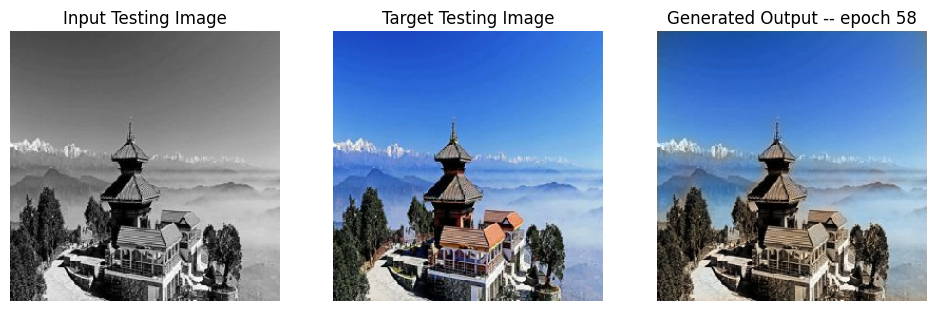

SSIM Score: 0.9633364081382751
PSNR Score: 25.475139617919922
LPIPS Score: 0.6367284059524536
Epoch 58
Training Details
Generator-- total_loss:15.55 gan_loss:13.06 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 25.73 LPIPS 0.88
Time taken for epoch 59 is 137.21881079673767 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.83 gan_loss:0.00 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:9.40 real_loss:9.39 generated_loss:0.00 --- SSIM 0.95 PSNR 25.12 LPIPS 0.94
Time taken for epoch 59 is 163.46097350120544 sec
Number of iteration 140
Epoch 59
Training Details
Generator-- total_loss:15.72 gan_loss:13.22 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 25.73 LPIPS 0.88
Time taken for epoch 60 is 138.50418901443481 sec
Number of iteration 490
Testing Details
Generator-- total_lo

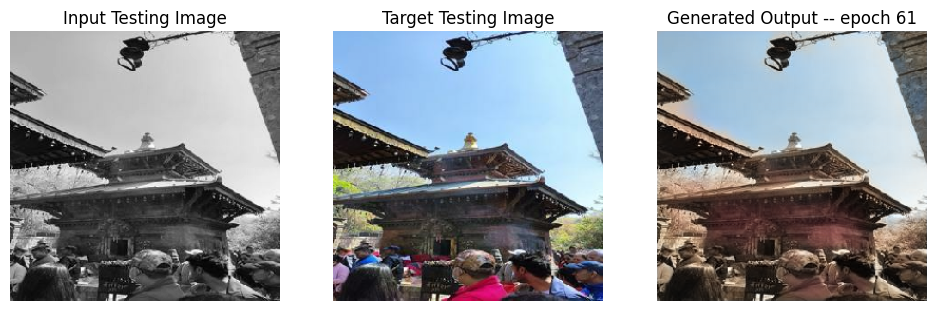

SSIM Score: 0.961078405380249
PSNR Score: 22.66948699951172
LPIPS Score: 1.047025203704834
Epoch 61
Training Details
Generator-- total_loss:15.26 gan_loss:12.78 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.01 real_loss:0.01 generated_loss:0.01 --- SSIM 0.96 PSNR 25.75 LPIPS 0.88
Time taken for epoch 62 is 137.70038223266602 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.84 gan_loss:0.01 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:7.62 real_loss:7.59 generated_loss:0.04 --- SSIM 0.95 PSNR 25.11 LPIPS 0.94
Time taken for epoch 62 is 163.54117703437805 sec
Number of iteration 140
Epoch 62
Training Details
Generator-- total_loss:15.11 gan_loss:12.63 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.01 real_loss:0.00 generated_loss:0.01 --- SSIM 0.96 PSNR 25.74 LPIPS 0.88
Time taken for epoch 63 is 138.4521553516388 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2

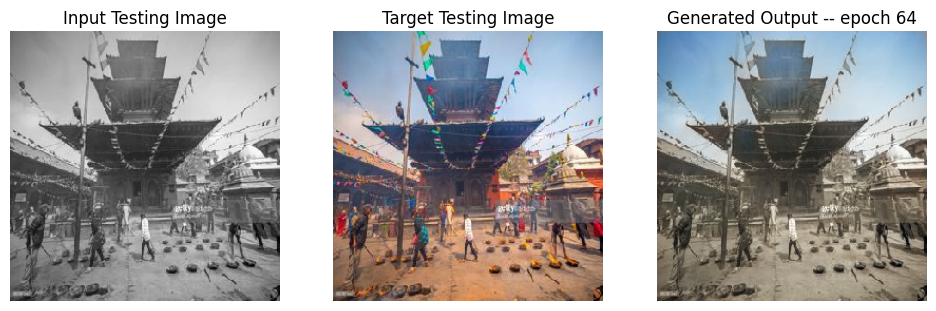

SSIM Score: 0.9382185935974121
PSNR Score: 22.947206497192383
LPIPS Score: 1.586500644683838
Epoch 64
Training Details
Generator-- total_loss:15.89 gan_loss:13.40 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 25.73 LPIPS 0.88
Time taken for epoch 65 is 138.265563249588 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.83 gan_loss:0.00 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:9.66 real_loss:9.66 generated_loss:0.01 --- SSIM 0.95 PSNR 25.11 LPIPS 0.94
Time taken for epoch 65 is 164.322101354599 sec
Number of iteration 140
Epoch 65
Training Details
Generator-- total_loss:15.75 gan_loss:13.27 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 25.74 LPIPS 0.88
Time taken for epoch 66 is 137.04084539413452 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.

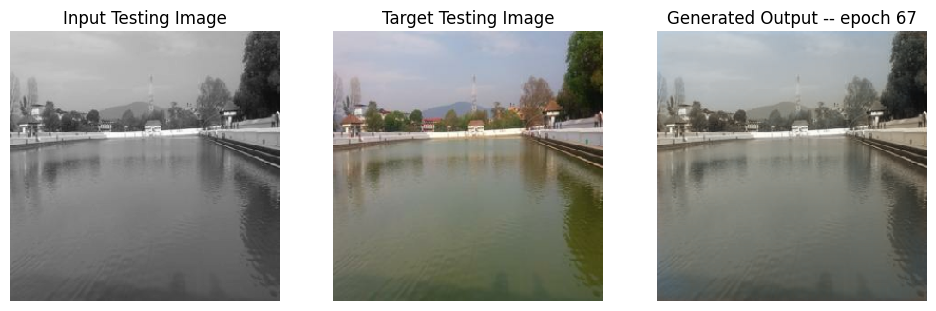

SSIM Score: 0.9762999415397644
PSNR Score: 29.45604133605957
LPIPS Score: 0.3023366332054138
Reduced generator learning rate to 0.0001250000059371814 at epoch 67
Epoch 67
Training Details
Generator-- total_loss:2.58 gan_loss:0.04 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:13.52 real_loss:13.52 generated_loss:0.00 --- SSIM 0.96 PSNR 25.40 LPIPS 0.91
Time taken for epoch 68 is 166.2612602710724 sec
Number of iteration 490
Testing Details
Generator-- total_loss:3.55 gan_loss:0.00 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:23.97 real_loss:23.97 generated_loss:0.00 --- SSIM 0.95 PSNR 22.99 LPIPS 1.08
Time taken for epoch 68 is 192.35245966911316 sec
Number of iteration 140
Epoch 68
Training Details
Generator-- total_loss:2.54 gan_loss:0.01 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:13.71 real_loss:13.71 generated_loss:0.00 --- SSIM 0.96 PSNR 25.43 LPIPS 0.91
Time taken for epoch 69 is 168.5366075038

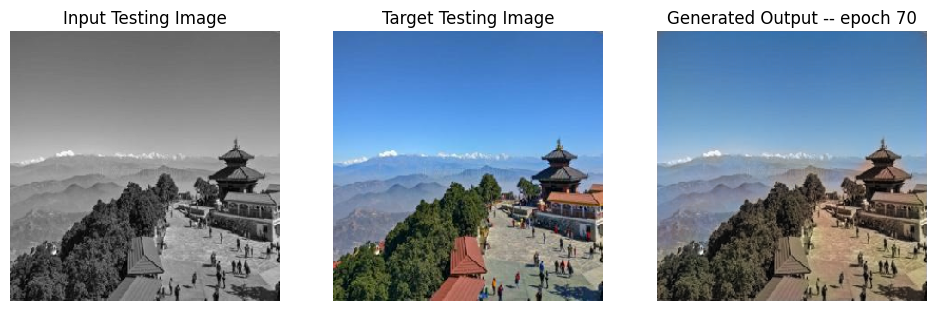

SSIM Score: 0.9603726267814636
PSNR Score: 23.54810333251953
LPIPS Score: 0.603781521320343
Epoch 70
Training Details
Generator-- total_loss:2.52 gan_loss:0.01 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:13.49 real_loss:13.49 generated_loss:0.00 --- SSIM 0.96 PSNR 25.50 LPIPS 0.91
Time taken for epoch 71 is 167.8836374282837 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.91 gan_loss:0.00 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:17.10 real_loss:17.10 generated_loss:0.00 --- SSIM 0.95 PSNR 24.89 LPIPS 0.95
Time taken for epoch 71 is 193.9142563343048 sec
Number of iteration 140
Epoch 71
Training Details
Generator-- total_loss:2.51 gan_loss:0.01 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:13.37 real_loss:13.37 generated_loss:0.00 --- SSIM 0.96 PSNR 25.53 LPIPS 0.90
Time taken for epoch 72 is 168.3009831905365 sec
Number of iteration 490
Testing Details
Generator-- total_loss:

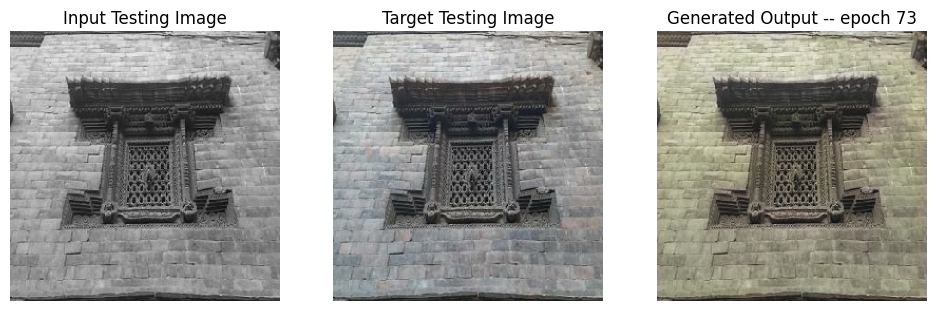

SSIM Score: 0.9910545349121094
PSNR Score: 26.7738094329834
LPIPS Score: 0.15680783987045288
Epoch 73
Training Details
Generator-- total_loss:2.50 gan_loss:0.01 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:12.78 real_loss:12.78 generated_loss:0.00 --- SSIM 0.96 PSNR 25.56 LPIPS 0.90
Time taken for epoch 74 is 163.11553692817688 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.97 gan_loss:0.00 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:15.73 real_loss:15.73 generated_loss:0.00 --- SSIM 0.95 PSNR 24.75 LPIPS 0.97
Time taken for epoch 74 is 189.050612449646 sec
Number of iteration 140
Reduced discriminator learning rate to 2.700000040931627e-05 at epoch 74.
Epoch 74
Training Details
Generator-- total_loss:10.07 gan_loss:7.57 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.14 real_loss:0.06 generated_loss:0.08 --- SSIM 0.96 PSNR 25.54 LPIPS 0.90
Time taken for epoch 75 is 137.1772964

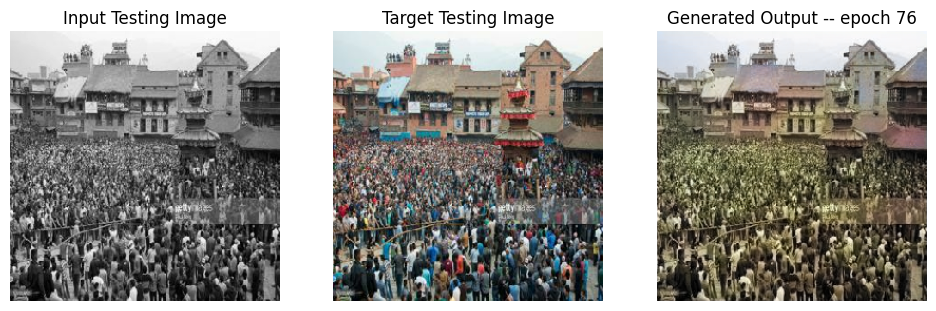

SSIM Score: 0.9540181159973145
PSNR Score: 23.543874740600586
LPIPS Score: 1.9317349195480347
Epoch 76
Training Details
Generator-- total_loss:10.37 gan_loss:7.86 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.02 real_loss:0.01 generated_loss:0.01 --- SSIM 0.96 PSNR 25.53 LPIPS 0.91
Time taken for epoch 77 is 137.3794403076172 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.90 gan_loss:0.01 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:6.03 real_loss:6.01 generated_loss:0.02 --- SSIM 0.95 PSNR 24.91 LPIPS 0.96
Time taken for epoch 77 is 163.44721579551697 sec
Number of iteration 140
Epoch 77
Training Details
Generator-- total_loss:11.72 gan_loss:9.21 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.02 real_loss:0.01 generated_loss:0.01 --- SSIM 0.96 PSNR 25.54 LPIPS 0.91
Time taken for epoch 78 is 136.78944206237793 sec
Number of iteration 490
Testing Details
Generator-- total_loss:

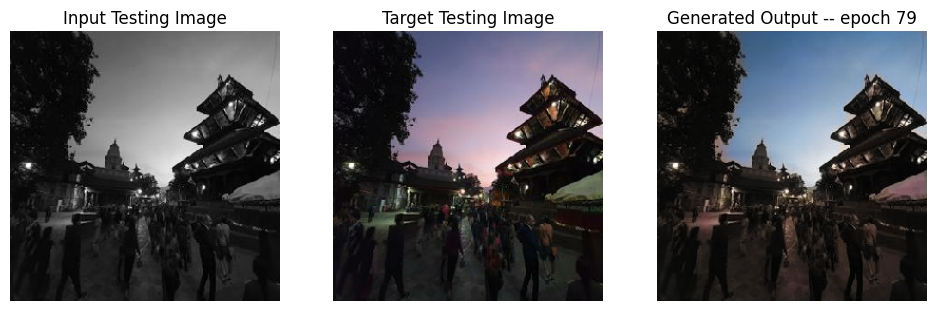

SSIM Score: 0.97517329454422
PSNR Score: 27.350366592407227
LPIPS Score: 0.34062981605529785
Reduced generator learning rate to 6.25000029685907e-05 at epoch 79
Epoch 79
Training Details
Generator-- total_loss:2.58 gan_loss:0.03 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:8.15 real_loss:8.15 generated_loss:0.01 --- SSIM 0.95 PSNR 25.39 LPIPS 0.92
Time taken for epoch 80 is 167.5600242614746 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.98 gan_loss:0.00 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:11.21 real_loss:11.21 generated_loss:0.00 --- SSIM 0.95 PSNR 24.63 LPIPS 0.98
Time taken for epoch 80 is 193.6733160018921 sec
Number of iteration 140
Epoch 80
Training Details
Generator-- total_loss:2.52 gan_loss:0.01 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:8.13 real_loss:8.11 generated_loss:0.02 --- SSIM 0.95 PSNR 25.54 LPIPS 0.90
Time taken for epoch 81 is 168.31702995300293 s

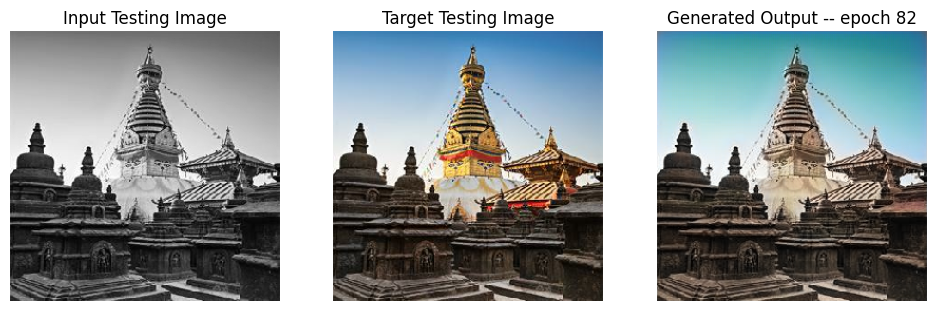

SSIM Score: 0.9568062424659729
PSNR Score: 25.61160659790039
LPIPS Score: 0.7405205368995667
Epoch 82
Training Details
Generator-- total_loss:2.49 gan_loss:0.01 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:8.22 real_loss:8.22 generated_loss:0.01 --- SSIM 0.95 PSNR 25.64 LPIPS 0.89
Time taken for epoch 83 is 163.55854272842407 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.91 gan_loss:0.00 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:11.41 real_loss:11.41 generated_loss:0.00 --- SSIM 0.95 PSNR 24.82 LPIPS 0.95
Time taken for epoch 83 is 188.91854572296143 sec
Number of iteration 140
Epoch 83
Training Details
Generator-- total_loss:2.49 gan_loss:0.01 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:8.03 real_loss:8.03 generated_loss:0.00 --- SSIM 0.95 PSNR 25.65 LPIPS 0.89
Time taken for epoch 84 is 161.0824999809265 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2

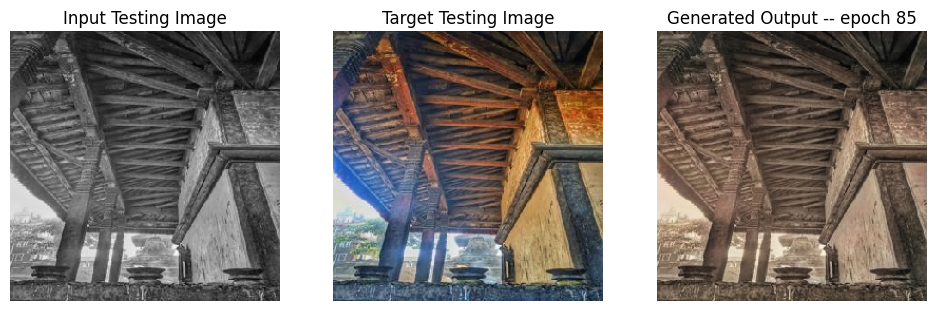

SSIM Score: 0.9404704570770264
PSNR Score: 20.667556762695312
LPIPS Score: 1.2610762119293213
Epoch 85
Training Details
Generator-- total_loss:2.48 gan_loss:0.01 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:8.14 real_loss:8.13 generated_loss:0.01 --- SSIM 0.95 PSNR 25.70 LPIPS 0.89
Time taken for epoch 86 is 166.19783735275269 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.91 gan_loss:0.00 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:11.50 real_loss:11.50 generated_loss:0.00 --- SSIM 0.95 PSNR 24.81 LPIPS 0.95
Time taken for epoch 86 is 192.07981157302856 sec
Number of iteration 140
Reduced discriminator learning rate to 8.100000013655517e-06 at epoch 86.
Epoch 86
Training Details
Generator-- total_loss:6.36 gan_loss:3.88 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.37 real_loss:0.17 generated_loss:0.20 --- SSIM 0.95 PSNR 25.66 LPIPS 0.89
Time taken for epoch 87 is 137.4235045

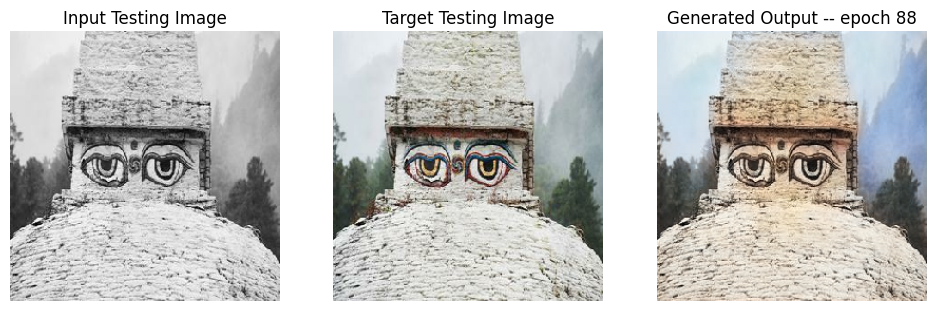

SSIM Score: 0.9871408343315125
PSNR Score: 27.501951217651367
LPIPS Score: 0.35292208194732666
Epoch 88
Training Details
Generator-- total_loss:8.05 gan_loss:5.57 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.06 real_loss:0.02 generated_loss:0.04 --- SSIM 0.95 PSNR 25.66 LPIPS 0.89
Time taken for epoch 89 is 137.65861558914185 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.97 gan_loss:0.02 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:5.08 real_loss:5.05 generated_loss:0.03 --- SSIM 0.95 PSNR 24.68 LPIPS 0.96
Time taken for epoch 89 is 163.58676958084106 sec
Number of iteration 140
Epoch 89
Training Details
Generator-- total_loss:9.10 gan_loss:6.62 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.02 real_loss:0.01 generated_loss:0.01 --- SSIM 0.95 PSNR 25.66 LPIPS 0.89
Time taken for epoch 90 is 136.93743538856506 sec
Number of iteration 490
Testing Details
Generator-- total_loss:

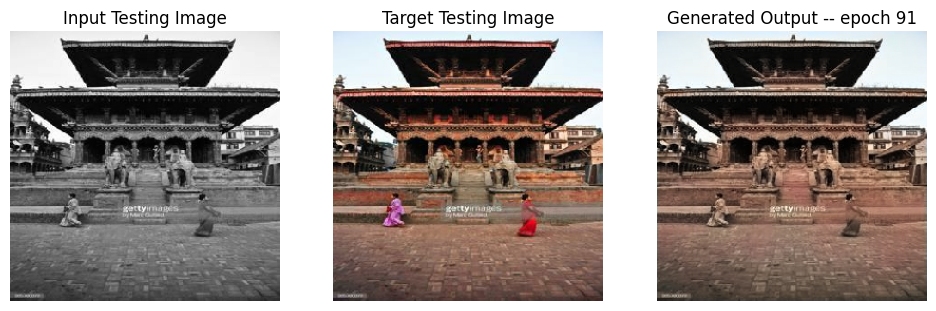

SSIM Score: 0.9739797711372375
PSNR Score: 28.439287185668945
LPIPS Score: 0.7360305190086365
Epoch 91
Training Details
Generator-- total_loss:9.76 gan_loss:7.27 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.01 real_loss:0.01 generated_loss:0.01 --- SSIM 0.95 PSNR 25.65 LPIPS 0.89
Time taken for epoch 92 is 139.13926362991333 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.96 gan_loss:0.02 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:4.89 real_loss:4.86 generated_loss:0.03 --- SSIM 0.95 PSNR 24.71 LPIPS 0.96
Time taken for epoch 92 is 165.03750038146973 sec
Number of iteration 140
Reduced generator learning rate to 3.125000148429535e-05 at epoch 92
Epoch 92
Training Details
Generator-- total_loss:2.58 gan_loss:0.04 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:6.99 real_loss:6.99 generated_loss:0.01 --- SSIM 0.95 PSNR 25.33 LPIPS 0.93
Time taken for epoch 93 is 168.05886054039001

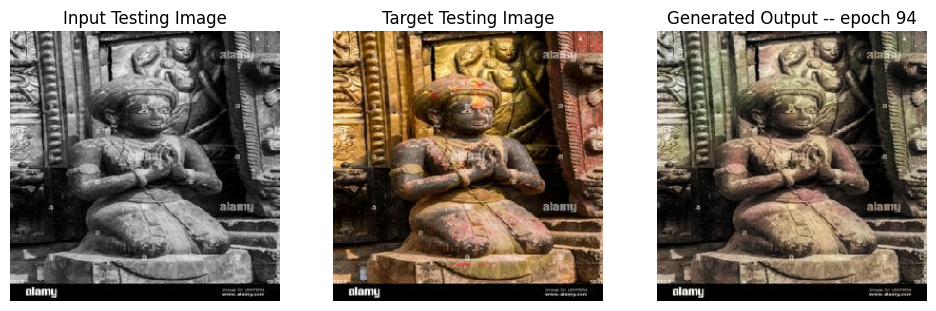

SSIM Score: 0.939985990524292
PSNR Score: 22.74814796447754
LPIPS Score: 0.878636360168457
Epoch 94
Training Details
Generator-- total_loss:2.49 gan_loss:0.01 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:8.71 real_loss:8.70 generated_loss:0.00 --- SSIM 0.95 PSNR 25.57 LPIPS 0.90
Time taken for epoch 95 is 168.22963500022888 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.86 gan_loss:0.00 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:10.54 real_loss:10.54 generated_loss:0.00 --- SSIM 0.95 PSNR 24.93 LPIPS 0.95
Time taken for epoch 95 is 194.22748732566833 sec
Number of iteration 140
Epoch 95
Training Details
Generator-- total_loss:2.49 gan_loss:0.01 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:8.81 real_loss:8.80 generated_loss:0.01 --- SSIM 0.95 PSNR 25.59 LPIPS 0.90
Time taken for epoch 96 is 168.0220911502838 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.8

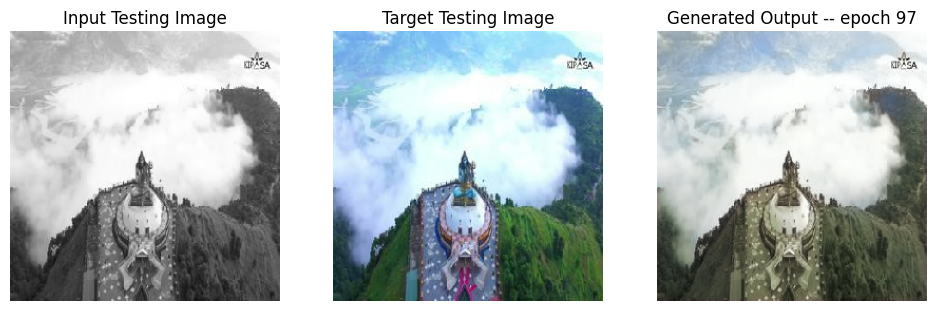

SSIM Score: 0.9477911591529846
PSNR Score: 21.531932830810547
LPIPS Score: 0.9526204466819763
Epoch 97
Training Details
Generator-- total_loss:2.48 gan_loss:0.01 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:8.50 real_loss:8.50 generated_loss:0.01 --- SSIM 0.96 PSNR 25.62 LPIPS 0.90
Time taken for epoch 98 is 163.9551932811737 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.91 gan_loss:0.00 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:10.65 real_loss:10.65 generated_loss:0.00 --- SSIM 0.95 PSNR 24.77 LPIPS 0.96
Time taken for epoch 98 is 189.9844913482666 sec
Number of iteration 140
Epoch 98
Training Details
Generator-- total_loss:2.48 gan_loss:0.01 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:8.36 real_loss:8.35 generated_loss:0.00 --- SSIM 0.96 PSNR 25.61 LPIPS 0.89
Time taken for epoch 99 is 167.44085383415222 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2

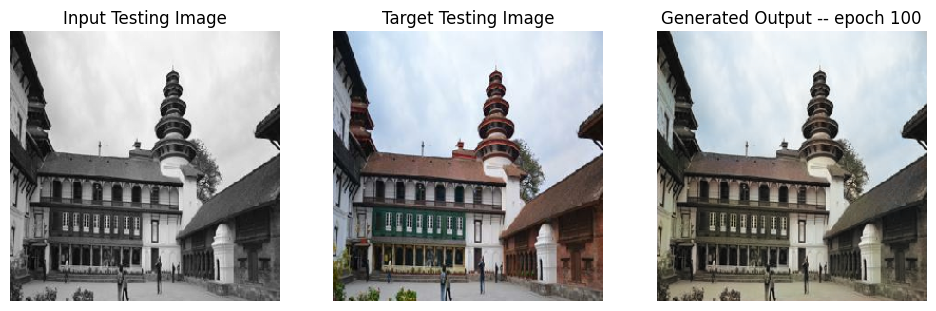

SSIM Score: 0.982950747013092
PSNR Score: 29.761619567871094
LPIPS Score: 0.46306127309799194
Epoch 100
Training Details
Generator-- total_loss:7.37 gan_loss:4.89 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.30 real_loss:0.11 generated_loss:0.19 --- SSIM 0.96 PSNR 25.60 LPIPS 0.90
Time taken for epoch 101 is 138.17424058914185 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.94 gan_loss:0.09 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:3.26 real_loss:3.10 generated_loss:0.16 --- SSIM 0.95 PSNR 24.95 LPIPS 0.95
Time taken for epoch 101 is 164.33819389343262 sec
Number of iteration 140
Epoch 101
Training Details
Generator-- total_loss:7.60 gan_loss:5.12 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.28 real_loss:0.09 generated_loss:0.19 --- SSIM 0.96 PSNR 25.59 LPIPS 0.90
Time taken for epoch 102 is 138.81841230392456 sec
Number of iteration 490
Testing Details
Generator-- total_l

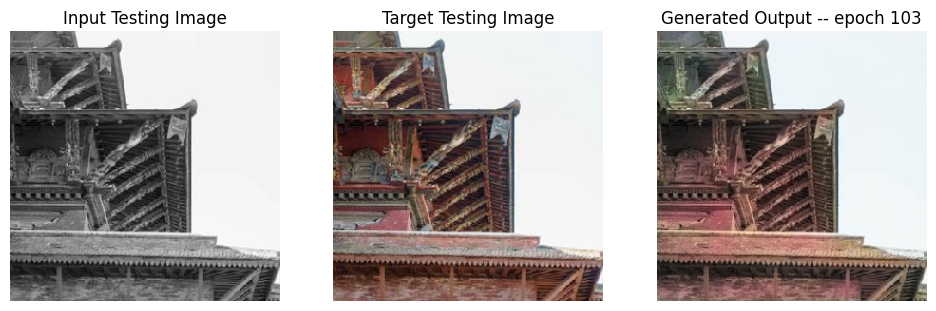

SSIM Score: 0.9768450856208801
PSNR Score: 28.111589431762695
LPIPS Score: 0.6913326978683472
Epoch 103
Training Details
Generator-- total_loss:2.57 gan_loss:0.02 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:6.83 real_loss:6.69 generated_loss:0.14 --- SSIM 0.95 PSNR 25.29 LPIPS 0.93
Time taken for epoch 104 is 166.45344066619873 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.93 gan_loss:0.00 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:7.94 real_loss:7.93 generated_loss:0.01 --- SSIM 0.95 PSNR 24.70 LPIPS 0.98
Time taken for epoch 104 is 191.93029022216797 sec
Number of iteration 140
Epoch 104
Training Details
Generator-- total_loss:2.57 gan_loss:0.01 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:6.72 real_loss:6.65 generated_loss:0.07 --- SSIM 0.95 PSNR 25.28 LPIPS 0.93
Time taken for epoch 105 is 162.51711511611938 sec
Number of iteration 490
Testing Details
Generator-- total_l

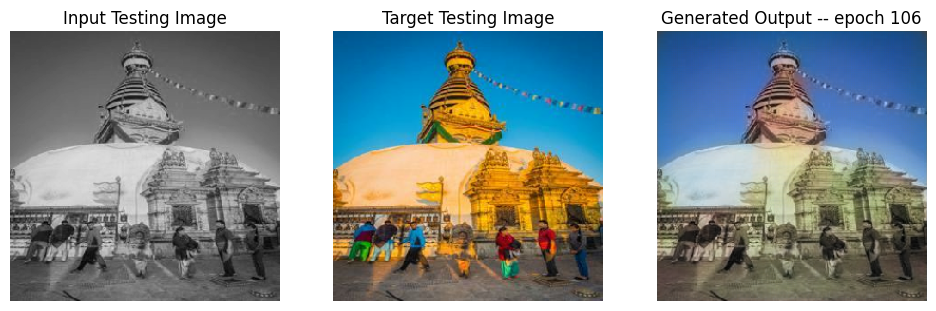

SSIM Score: 0.7433422207832336
PSNR Score: 16.300403594970703
LPIPS Score: 2.6453235149383545
Epoch 106
Training Details
Generator-- total_loss:2.56 gan_loss:0.01 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:6.41 real_loss:6.26 generated_loss:0.15 --- SSIM 0.95 PSNR 25.32 LPIPS 0.93
Time taken for epoch 107 is 164.0771725177765 sec
Number of iteration 490
Testing Details
Generator-- total_loss:2.93 gan_loss:0.00 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:7.75 real_loss:7.74 generated_loss:0.01 --- SSIM 0.95 PSNR 24.72 LPIPS 0.98
Time taken for epoch 107 is 189.3060426712036 sec
Number of iteration 140
Epoch 107
Training Details
Generator-- total_loss:2.56 gan_loss:0.01 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:6.58 real_loss:6.44 generated_loss:0.14 --- SSIM 0.95 PSNR 25.31 LPIPS 0.93
Time taken for epoch 108 is 162.14455580711365 sec
Number of iteration 490
Testing Details
Generator-- total_los

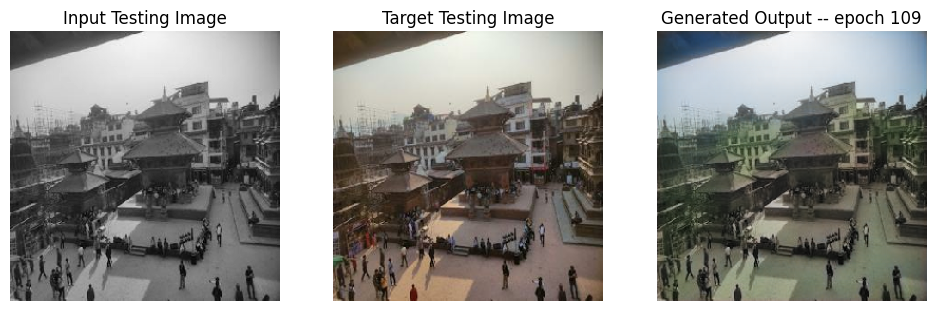

SSIM Score: 0.9791404604911804
PSNR Score: 26.504981994628906
LPIPS Score: 0.391072154045105
Epoch 109
Training Details
Generator-- total_loss:4.65 gan_loss:2.11 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:1.38 real_loss:0.47 generated_loss:0.92 --- SSIM 0.95 PSNR 25.36 LPIPS 0.92
Time taken for epoch 110 is 135.94350624084473 sec
Number of iteration 490
Testing Details
Generator-- total_loss:3.24 gan_loss:0.34 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:1.95 real_loss:1.50 generated_loss:0.45 --- SSIM 0.95 PSNR 24.78 LPIPS 0.97
Time taken for epoch 110 is 161.77712655067444 sec
Number of iteration 140
Epoch 110
Training Details
Generator-- total_loss:4.74 gan_loss:2.20 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:1.48 real_loss:0.43 generated_loss:1.05 --- SSIM 0.95 PSNR 25.34 LPIPS 0.92
Time taken for epoch 111 is 135.111896276474 sec
Number of iteration 490
Testing Details
Generator-- total_loss

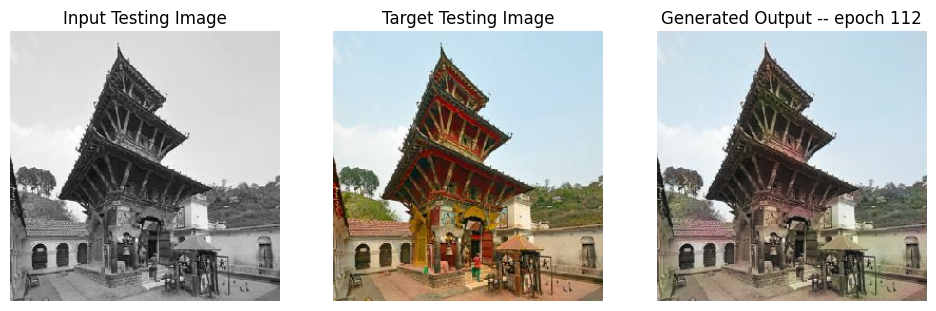

SSIM Score: 0.9468782544136047
PSNR Score: 24.874170303344727
LPIPS Score: 1.0623074769973755
Epoch 112
Training Details
Generator-- total_loss:4.83 gan_loss:2.29 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:1.16 real_loss:0.35 generated_loss:0.81 --- SSIM 0.95 PSNR 25.34 LPIPS 0.93
Time taken for epoch 113 is 135.03598928451538 sec
Number of iteration 490
Testing Details
Generator-- total_loss:3.26 gan_loss:0.35 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:1.86 real_loss:1.43 generated_loss:0.43 --- SSIM 0.95 PSNR 24.77 LPIPS 0.97
Time taken for epoch 113 is 160.4400029182434 sec
Number of iteration 140
Epoch 113
Training Details
Generator-- total_loss:4.88 gan_loss:2.35 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.95 real_loss:0.32 generated_loss:0.63 --- SSIM 0.95 PSNR 25.36 LPIPS 0.93
Time taken for epoch 114 is 134.42137503623962 sec
Number of iteration 490
Testing Details
Generator-- total_lo

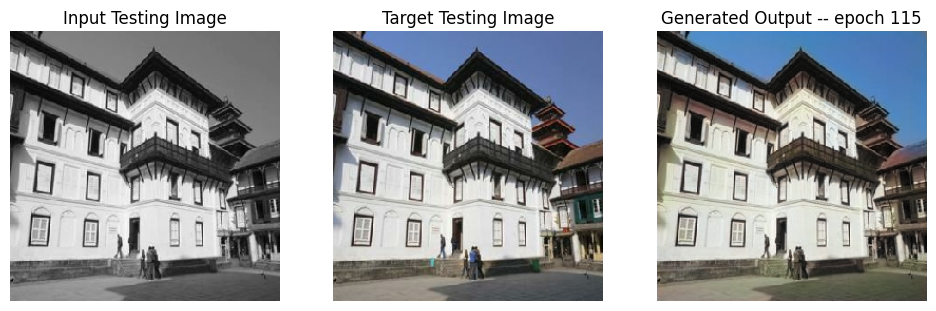

SSIM Score: 0.9768845438957214
PSNR Score: 29.01107406616211
LPIPS Score: 0.3950461745262146
Epoch 115
Training Details
Generator-- total_loss:4.93 gan_loss:2.39 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.89 real_loss:0.29 generated_loss:0.60 --- SSIM 0.95 PSNR 25.34 LPIPS 0.93
Time taken for epoch 116 is 138.52187776565552 sec
Number of iteration 490
Testing Details
Generator-- total_loss:3.19 gan_loss:0.28 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:1.96 real_loss:1.62 generated_loss:0.34 --- SSIM 0.95 PSNR 24.79 LPIPS 0.97
Time taken for epoch 116 is 164.0331904888153 sec
Number of iteration 140
Epoch 116
Training Details
Generator-- total_loss:4.88 gan_loss:2.35 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:0.83 real_loss:0.28 generated_loss:0.55 --- SSIM 0.95 PSNR 25.37 LPIPS 0.92
Time taken for epoch 117 is 135.6274185180664 sec
Number of iteration 490
Testing Details
Generator-- total_loss

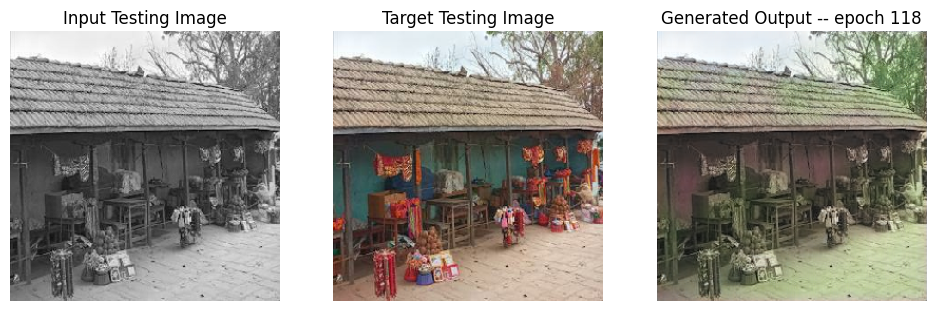

SSIM Score: 0.9572093486785889
PSNR Score: 24.695398330688477
LPIPS Score: 1.2166824340820312
Epoch 118
Training Details
Generator-- total_loss:2.70 gan_loss:0.03 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:4.98 real_loss:4.28 generated_loss:0.69 --- SSIM 0.95 PSNR 24.87 LPIPS 0.97
Time taken for epoch 119 is 166.24757623672485 sec
Number of iteration 490
Testing Details
Generator-- total_loss:3.08 gan_loss:0.03 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:3.83 real_loss:3.77 generated_loss:0.06 --- SSIM 0.94 PSNR 24.36 LPIPS 1.01
Time taken for epoch 119 is 192.1348421573639 sec
Number of iteration 140
Epoch 119
Training Details
Generator-- total_loss:2.69 gan_loss:0.03 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:4.89 real_loss:4.36 generated_loss:0.53 --- SSIM 0.95 PSNR 24.87 LPIPS 0.97
Time taken for epoch 120 is 164.99257802963257 sec
Number of iteration 490
Testing Details
Generator-- total_lo

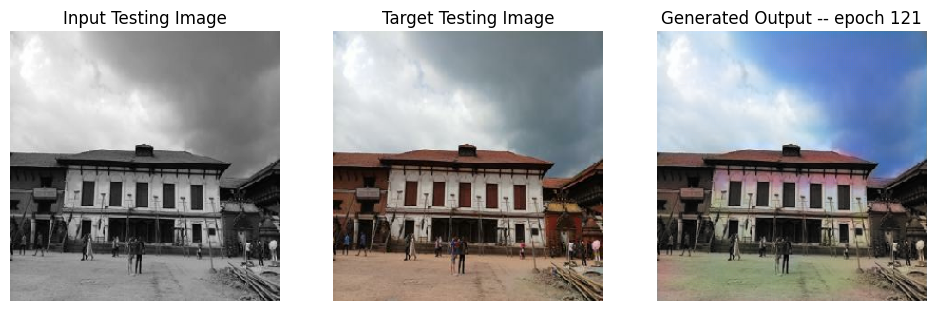

SSIM Score: 0.9462296962738037
PSNR Score: 22.436412811279297
LPIPS Score: 0.491067111492157
Epoch 121
Training Details
Generator-- total_loss:2.69 gan_loss:0.03 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:4.92 real_loss:4.33 generated_loss:0.59 --- SSIM 0.95 PSNR 24.89 LPIPS 0.97
Time taken for epoch 122 is 163.73672080039978 sec
Number of iteration 490
Testing Details
Generator-- total_loss:3.05 gan_loss:0.02 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:4.22 real_loss:4.18 generated_loss:0.04 --- SSIM 0.94 PSNR 24.38 LPIPS 1.01
Time taken for epoch 122 is 188.99209356307983 sec
Number of iteration 140
Epoch 122
Training Details
Generator-- total_loss:2.69 gan_loss:0.03 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:4.90 real_loss:4.37 generated_loss:0.53 --- SSIM 0.95 PSNR 24.88 LPIPS 0.97
Time taken for epoch 123 is 162.89264154434204 sec
Number of iteration 490
Testing Details
Generator-- total_lo

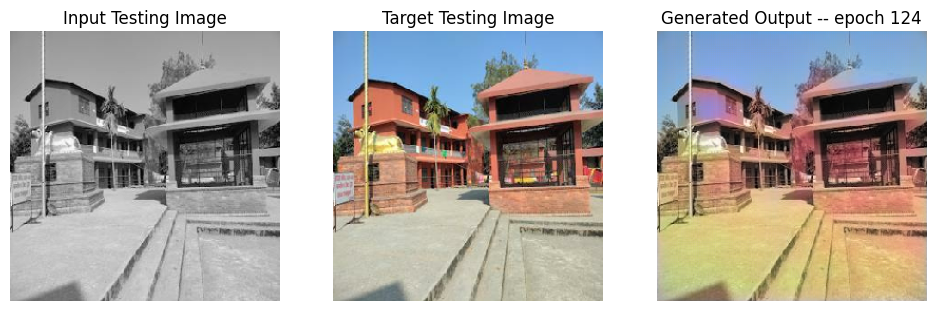

SSIM Score: 0.922339141368866
PSNR Score: 20.943330764770508
LPIPS Score: 1.3175736665725708
Epoch 124
Training Details
Generator-- total_loss:3.20 gan_loss:0.55 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:2.94 real_loss:1.36 generated_loss:1.58 --- SSIM 0.95 PSNR 24.90 LPIPS 0.97
Time taken for epoch 125 is 134.6516613960266 sec
Number of iteration 490
Testing Details
Generator-- total_loss:3.64 gan_loss:0.62 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:1.53 real_loss:0.96 generated_loss:0.57 --- SSIM 0.94 PSNR 24.40 LPIPS 1.01
Time taken for epoch 125 is 160.02975964546204 sec
Number of iteration 140
Epoch 125
Training Details
Generator-- total_loss:3.37 gan_loss:0.72 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:2.84 real_loss:1.08 generated_loss:1.76 --- SSIM 0.95 PSNR 24.90 LPIPS 0.97
Time taken for epoch 126 is 132.91547393798828 sec
Number of iteration 490
Testing Details
Generator-- total_los

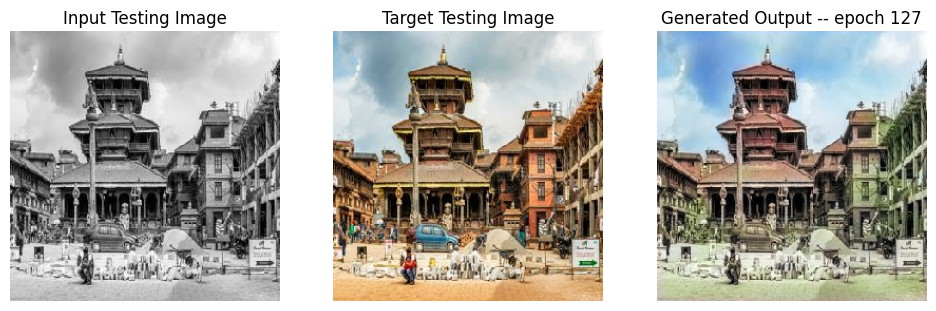

SSIM Score: 0.9553688168525696
PSNR Score: 22.36975860595703
LPIPS Score: 1.2061160802841187
Reduced generator learning rate to 3.906250185536919e-06 at epoch 127
Epoch 127
Training Details
Generator-- total_loss:2.86 gan_loss:0.09 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:4.83 real_loss:3.11 generated_loss:1.72 --- SSIM 0.94 PSNR 24.49 LPIPS 1.01
Time taken for epoch 128 is 162.1502001285553 sec
Number of iteration 490
Testing Details
Generator-- total_loss:3.36 gan_loss:0.22 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:2.11 real_loss:1.89 generated_loss:0.22 --- SSIM 0.94 PSNR 24.03 LPIPS 1.05
Time taken for epoch 128 is 187.52643656730652 sec
Number of iteration 140
Epoch 128
Training Details
Generator-- total_loss:2.85 gan_loss:0.07 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:5.10 real_loss:3.33 generated_loss:1.78 --- SSIM 0.94 PSNR 24.45 LPIPS 1.01
Time taken for epoch 129 is 162.5963034629

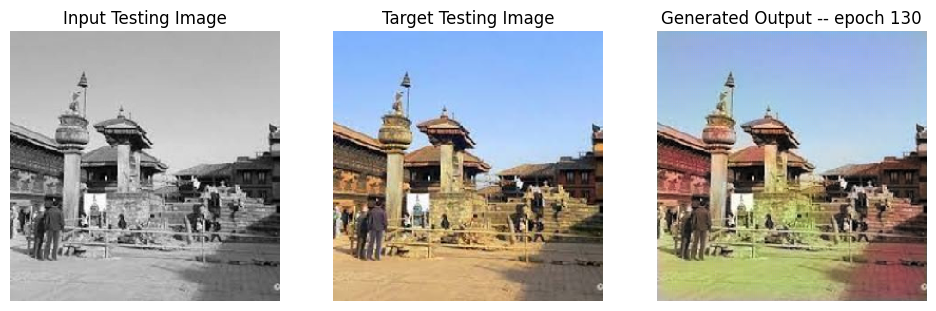

SSIM Score: 0.9372754096984863
PSNR Score: 24.69510269165039
LPIPS Score: 0.6482270956039429
Epoch 130
Training Details
Generator-- total_loss:2.85 gan_loss:0.06 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:4.98 real_loss:3.38 generated_loss:1.60 --- SSIM 0.94 PSNR 24.45 LPIPS 1.01
Time taken for epoch 131 is 161.6880123615265 sec
Number of iteration 490
Testing Details
Generator-- total_loss:3.35 gan_loss:0.21 l1_loss:0.04 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:2.20 real_loss:2.00 generated_loss:0.20 --- SSIM 0.94 PSNR 24.02 LPIPS 1.05
Time taken for epoch 131 is 187.06139302253723 sec
Number of iteration 140
Epoch 131
Training Details
Generator-- total_loss:2.84 gan_loss:0.06 l1_loss:0.03 l2_loss:0.00 perceptual_loss:0.00 Discriminator-- total_loss:5.09 real_loss:3.37 generated_loss:1.72 --- SSIM 0.94 PSNR 24.46 LPIPS 1.01
Time taken for epoch 132 is 163.67794823646545 sec
Number of iteration 490
Testing Details
Generator-- total_los

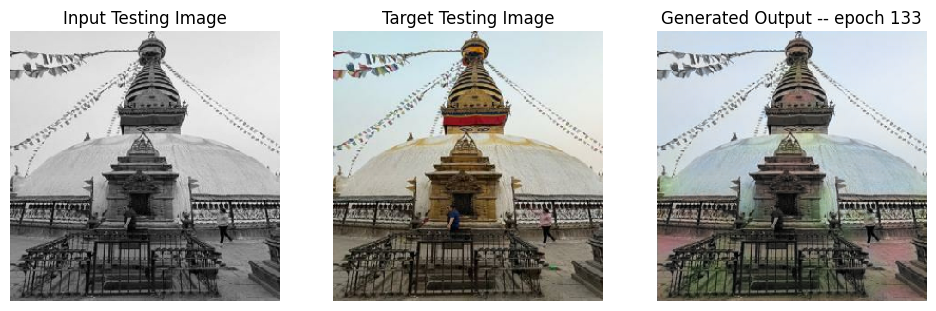

SSIM Score: 0.9749298095703125
PSNR Score: 27.806102752685547
LPIPS Score: 0.5018473863601685
Discriminator learning rate already at the minimum. Stopping training.


In [45]:
fit(train_dataset, epochs, test_dataset, gen)

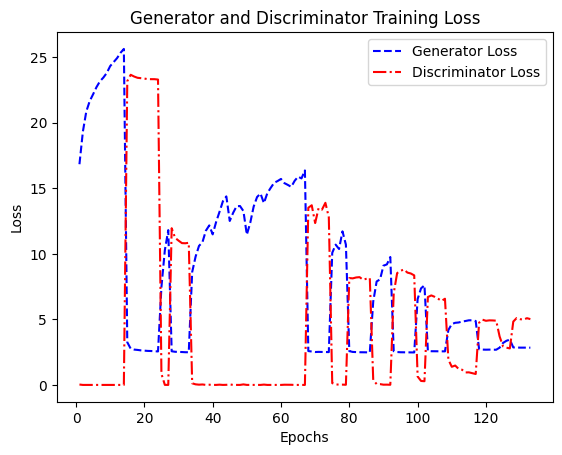

In [46]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_generator_losses, '--b', label='Generator Loss')
plt.plot(epochs, train_discriminator_losses, '-.r', label='Discriminator Loss')
plt.title('Generator and Discriminator Training Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/train_loss_plot_1.png')
plt.show()

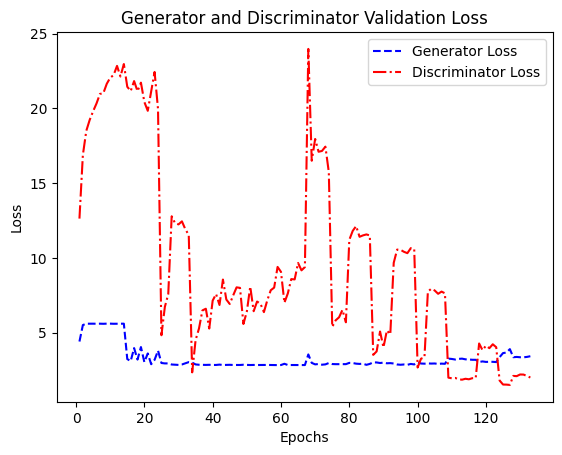

In [47]:
epochs = range(1, len(test_generator_losses) + 1)

plt.plot(epochs, test_generator_losses, '--b', label='Generator Loss')
plt.plot(epochs, test_discriminator_losses, '-.r', label='Discriminator Loss')
plt.title('Generator and Discriminator Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/test_loss_plot_1.png')
plt.show()

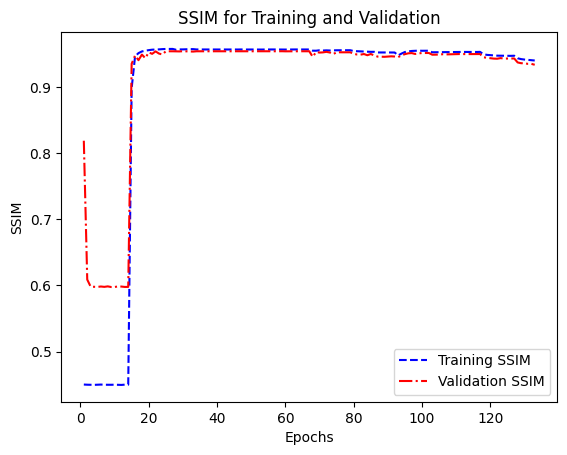

In [48]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, training_ssim, '--b', label='Training SSIM')
plt.plot(epochs, testing_ssim, '-.r', label='Validation SSIM')
plt.title('SSIM for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('SSIM')
plt.legend()
plt.savefig('/kaggle/working/SSIM_plot_1.png')
plt.show()

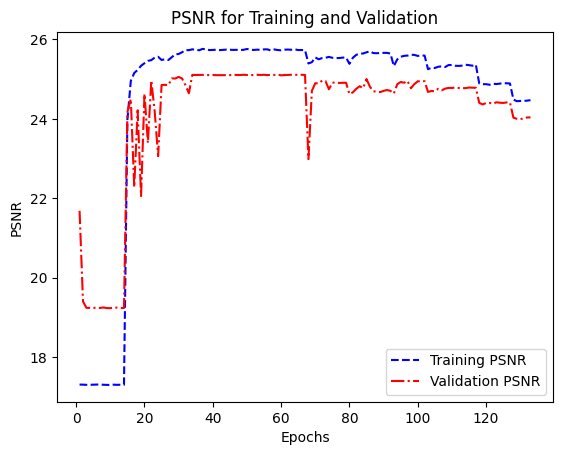

In [49]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, training_psnr, '--b', label='Training PSNR')
plt.plot(epochs, testing_psnr, '-.r', label='Validation PSNR')
plt.title('PSNR for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('PSNR')
plt.legend()
plt.savefig('/kaggle/working/PSNR_plot_1.png')
plt.show()

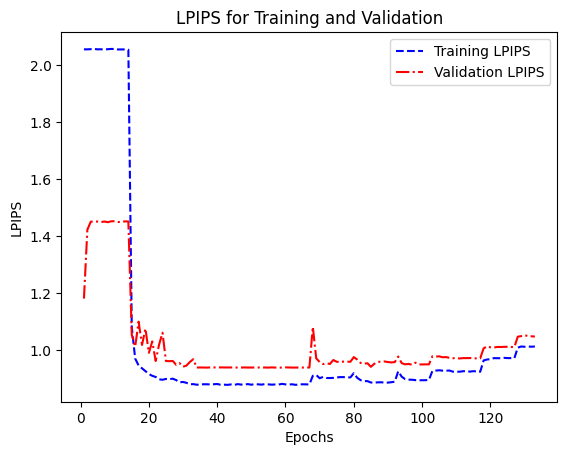

In [50]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, training_lpips, '--b', label='Training LPIPS')
plt.plot(epochs, testing_lpips, '-.r', label='Validation LPIPS')
plt.title('LPIPS for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('LPIPS')
plt.legend()
plt.savefig('/kaggle/working/LPIPS_plot_1.png')
plt.show()

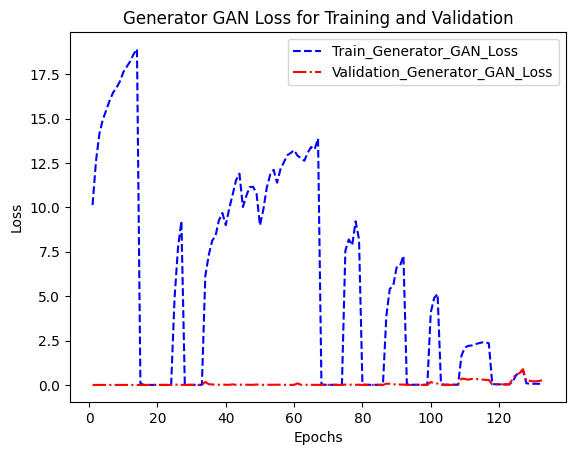

In [51]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_generator_gan_losses, '--b', label='Train_Generator_GAN_Loss')
plt.plot(epochs, test_generator_gan_losses, '-.r', label='Validation_Generator_GAN_Loss')
plt.title('Generator GAN Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Gen_GAN_plot_1.png')
plt.show()

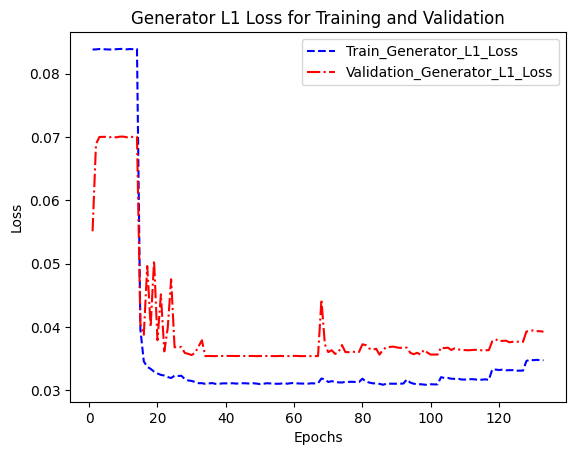

In [52]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_generator_l1_losses, '--b', label='Train_Generator_L1_Loss')
plt.plot(epochs, test_generator_l1_losses, '-.r', label='Validation_Generator_L1_Loss')
plt.title('Generator L1 Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Gen_L1_plot_1.png')
plt.show()

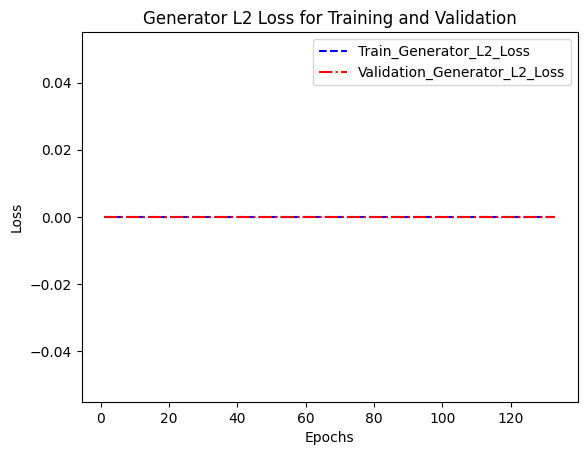

In [53]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_generator_l2_losses, '--b', label='Train_Generator_L2_Loss')
plt.plot(epochs, test_generator_l2_losses, '-.r', label='Validation_Generator_L2_Loss')
plt.title('Generator L2 Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Gen_L2_plot_1.png')
plt.show()

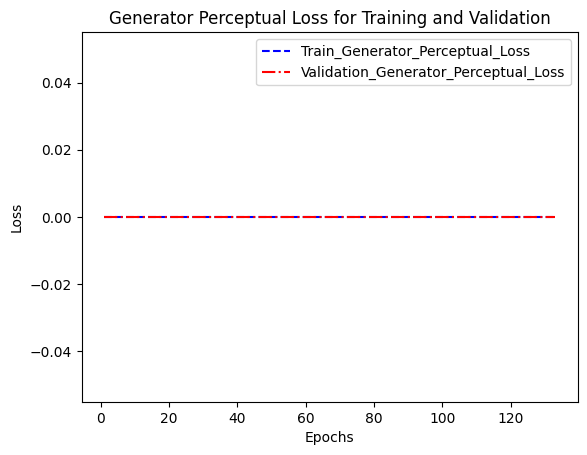

In [54]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_generator_perceptual_losses, '--b', label='Train_Generator_Perceptual_Loss')
plt.plot(epochs, test_generator_perceptual_losses, '-.r', label='Validation_Generator_Perceptual_Loss')
plt.title('Generator Perceptual Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Gen_Perceptual_plot_1.png')
plt.show()

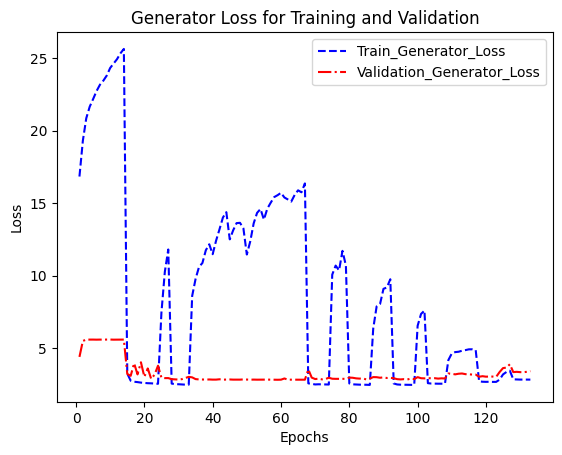

In [55]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_generator_losses, '--b', label='Train_Generator_Loss')
plt.plot(epochs, test_generator_losses, '-.r', label='Validation_Generator_Loss')
plt.title('Generator Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Gen_plot_1.png')
plt.show()

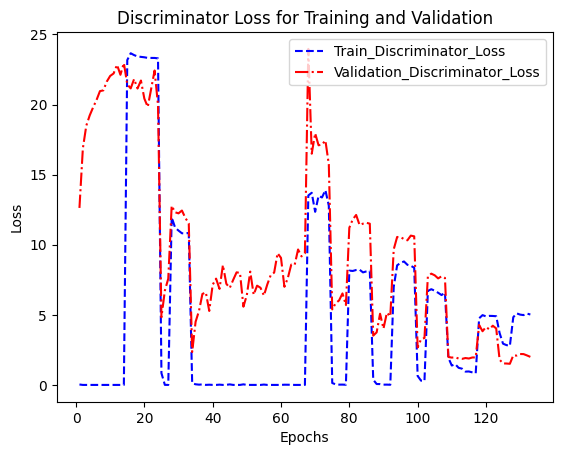

In [56]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_discriminator_losses, '--b', label='Train_Discriminator_Loss')
plt.plot(epochs, test_discriminator_losses, '-.r', label='Validation_Discriminator_Loss')
plt.title('Discriminator Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Disc_plot_1.png')
plt.show()

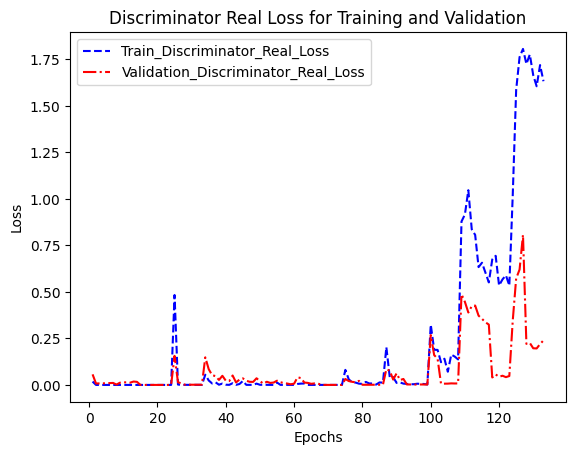

In [57]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_discriminator_real_losses, '--b', label='Train_Discriminator_Real_Loss')
plt.plot(epochs, test_discriminator_real_losses, '-.r', label='Validation_Discriminator_Real_Loss')
plt.title('Discriminator Real Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Disc_Real_plot_1.png')
plt.show()

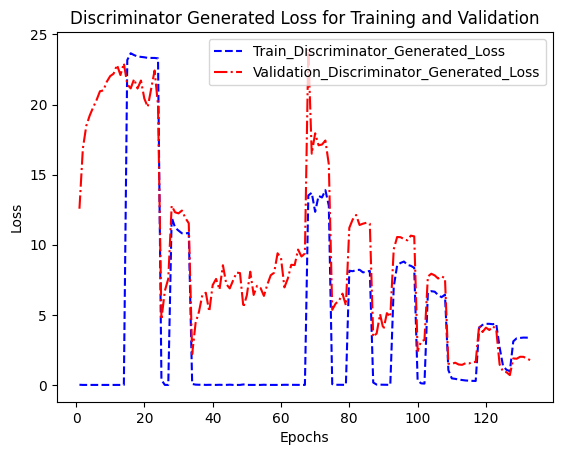

In [58]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_discriminator_generated_losses, '--b', label='Train_Discriminator_Generated_Loss')
plt.plot(epochs, test_discriminator_generated_losses, '-.r', label='Validation_Discriminator_Generated_Loss')
plt.title('Discriminator Generated Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Disc_Generated_plot_1.png')
plt.show()

In [59]:
import csv
with open('/kaggle/working/dataJan20.csv','w', newline='') as file:
    writer = csv.writer(file)
    writer.writerows(all_records)

In [60]:
os.mkdir('/kaggle/working/modelsJan20')

In [61]:
gen.save('/kaggle/working/modelsJan20/gen.h5')
gen.save_weights('/kaggle/working/modelsJan20/gen.keras')
disc.save('/kaggle/working/modelsJan20/disc.h5')
disc.save_weights('/kaggle/working/modelsJan20/disc.keras')

/opt/conda/lib/python3.10/site-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [62]:
def download_file(path, download_file_name):
    os.chdir('/kaggle/working/')
    zip_name = f"/kaggle/working/{download_file_name}.zip"
    command = f"zip {zip_name} {path} -r"
    result = subprocess.run(command, shell=True, capture_output=True, text=True)
    if result.returncode !=0:
        print("Unable to run zip command")
        print(result.stderr)
        return
    display(FileLink(f'{download_file_name}.zip'))

In [63]:
import subprocess
from IPython.display import FileLink, display

In [64]:
download_file('/kaggle/working', 'outputJan20')

/kaggle/working/outputJan20.zip